In [1]:
import numpy as np
import glob
import json

from skimage import draw

import matplotlib.pyplot as plt

import os
from cv2 import cv2

from PIL import Image

import random

import tifffile as tiff

import pandas as pd

from collections import OrderedDict

import cv2
import numpy as np
# import openslide
import torch
import torch.nn as nn
import torchvision.models as models
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms
from skimage.color import rgb2gray
import matplotlib.pyplot as plt
from tifffile import memmap

import albumentations as A

from skimage import morphology as morph

import skimage
from skimage.color import rgb2gray, rgb2hed, hed2rgb, rgb2hsv, hsv2rgb
from skimage.exposure import rescale_intensity
from skimage.util import dtype

import torch
import torch.nn.functional as F

import torchvision
from torchvision import transforms

import logging

import warnings
warnings.filterwarnings("ignore")

from SwinUnet.networks.vision_transformer import SwinUnet as ViT_seg

from scipy.ndimage import measurements
from skimage.morphology import remove_small_objects

import segmentation_models_pytorch as smp

import numpy as np
import os
import pandas as pd
from tqdm.auto import tqdm

from metrics.stats_utils import get_pq, get_multi_pq_info, get_multi_r2

from scipy.ndimage import filters, measurements
from scipy.ndimage.morphology import (
    binary_dilation,
    binary_fill_holes,
    distance_transform_cdt,
    distance_transform_edt,
)

from skimage.segmentation import watershed

import sys
sys.path.append('segmenter/')

from segmenter.segm.model.factory import create_segmenter


from my_misc import *
from my_misc import __proc_np_hv


from hover_net.run_utils.utils import (
    check_manual_seed, colored,
    convert_pytorch_checkpoint
)


import torch.cuda.amp as amp  
scaler = amp.GradScaler()


from hover_net.models.hovernet.net_desc import HoVerNetExt

In [4]:
def process_segmentation_original(np_map, hv_map, tp_map):
    # HoVerNet post-proc is coded at 0.25mpp so we resize
    np_map = cv2.resize(np_map, (0, 0), fx=2.0, fy=2.0)
    hv_map = cv2.resize(hv_map, (0, 0), fx=2.0, fy=2.0)
    tp_map = cv2.resize(
                    tp_map, (0, 0), fx=2.0, fy=2.0,
                    interpolation=cv2.INTER_NEAREST)

    inst_map = __proc_np_hv(np_map[..., None], hv_map)
    inst_dict = get_instance_info(inst_map, tp_map)

    # Generating results match with the evaluation protocol
    type_map = np.zeros_like(inst_map)
    inst_type_colours = np.array([
        [v['type']] * 3 for v in inst_dict.values()
    ])
    type_map = overlay_prediction_contours(
        type_map, inst_dict,
        line_thickness=-1,
        inst_colours=inst_type_colours)

    pred_map = np.dstack([inst_map, type_map])
    # The result for evaluation is at 0.5mpp so we scale back
    pred_map = cv2.resize(
                    pred_map, (0, 0), fx=0.5, fy=0.5,
                    interpolation=cv2.INTER_NEAREST)
    return pred_map

def process_segmentation(output_binary, output_hv, output_classification):

    np_map = torch.softmax(output_binary, 1)[0].cpu().detach().permute(1, 2, 0)[..., 1].unsqueeze(2).numpy()
    np_map = cv2.resize(np_map.astype('float32'), (0, 0), fx=2.0, fy=2.0)

    hv_map = output_hv[0].cpu().detach().permute(1, 2, 0).numpy().astype('float32')
    hv_map = cv2.resize(hv_map, (0, 0), fx=2.0, fy=2.0) 

    tp_map = torch.argmax(torch.softmax(output_classification, 1), 1).cpu().numpy()[0]
    tp_map = cv2.resize(tp_map, (0, 0), fx=2.0, fy=2.0, interpolation=cv2.INTER_NEAREST).astype('float32')

    inst_map = __proc_np_hv(np_map[..., None], hv_map)
    inst_dict = get_instance_info(inst_map, tp_map)

    type_map = np.zeros_like(inst_map)
    inst_type_colours = np.array([
        [v['type']] * 3 for v in inst_dict.values()
    ])
    type_map = overlay_prediction_contours(
        type_map, inst_dict,
        line_thickness=-1,
        inst_colours=inst_type_colours)

    pred_map = np.dstack([inst_map, type_map])

    pred_map = cv2.resize(pred_map, (0, 0), fx=0.5, fy=0.5, interpolation=cv2.INTER_NEAREST)
    
    return pred_map





def process_segmentation_2branch(output_binary, output_classification):

    tp_map = torch.argmax(torch.softmax(output_classification, 1), 1).cpu().numpy()[0]

    temp = torch.argmax(torch.softmax(output_binary, 1), 1).cpu()[0]
    inst_map = measurements.label(temp)[0]
    inst_map = remove_small_objects(inst_map, 10)
    
    inst_dict = get_instance_info(inst_map, tp_map)

    type_map = np.zeros_like(inst_map)
    inst_type_colours = np.array([
        [v['type']] * 3 for v in inst_dict.values()
    ])
    type_map = overlay_prediction_contours(
        type_map, inst_dict,
        line_thickness=-1,
        inst_colours=inst_type_colours)

    pred_map = np.dstack([inst_map, type_map])

    
    return pred_map




class ConicDataset(Dataset):

    def __init__(self, image_path, mask_path, counts, source, transform, copypaste, copy_level):

        self.image_path = image_path
        self.mask_path = mask_path
        self.counts = counts
        self.source = source

        self.transform = transform
        self.copypaste = copypaste
        self.copy_level = copy_level
        
        
        with open('insufficient_class_alldict/insufficient_class_alldict.pickle','rb') as temp:
            self.insufficient_class_alldict = pickle.load(temp)  
        
        with open('insufficient_class_alldict/insufficient_class_alldict_consep.pickle','rb') as temp:
            self.insufficient_class_alldict_consep = pickle.load(temp)      
            
        with open('insufficient_class_alldict/insufficient_class_alldict_crag.pickle','rb') as temp:
            self.insufficient_class_alldict_crag = pickle.load(temp) 
            
        with open('insufficient_class_alldict/insufficient_class_alldict_dpath.pickle','rb') as temp:
            self.insufficient_class_alldict_dpath = pickle.load(temp) 
            
        with open('insufficient_class_alldict/insufficient_class_alldict_glas.pickle','rb') as temp:
            self.insufficient_class_alldict_glas = pickle.load(temp)       
            
        with open('insufficient_class_alldict/insufficient_class_alldict_pannuke.pickle','rb') as temp:
            self.insufficient_class_alldict_pannuke = pickle.load(temp)             
            
   

    def __len__(self):
        return (len(self.image_path))

    def __getitem__(self, idx):

        image = self.image_path[idx].astype('uint8')
        original = image.copy()

        mask = self.mask_path[idx]
        
        mask_instance = mask[..., 0]
        mask_class = mask[..., 1]
        
        counts = self.counts[idx]
        source = self.source[idx]
        
        
        class1_copy_num = np.random.randint(24)
        class2_copy_num = np.random.randint(6)
        class3_copy_num = np.random.randint(11)
        class4_copy_num = np.random.randint(12)
        class5_copy_num = np.random.randint(24)
        class6_copy_num = np.random.randint(11)
        resize_rate = 1
        
        
        if self.copypaste:
            
            if self.copy_level == 'random':
                dict_ = self.insufficient_class_alldict
                
                if random.random() > 0.5:
                    
                    print('Copy Paste !')
                    
                    copypaste_result = copypaste_random_instance(image, mask_instance, mask_class, 
                                                                 class1_copy_num, class2_copy_num, class3_copy_num, 
                                                                 class4_copy_num, class5_copy_num, class6_copy_num, dict_, resize_rate)

                    image = copypaste_result['pasted_image']
                    mask_instance = copypaste_result['pasted_mask_instance']
                    mask_class = copypaste_result['pasted_mask_class']
              
            
            elif self.copy_level == 'source':
                
                if source == 'consep':
                    dict_ = self.insufficient_class_alldict_consep
                    
                if source == 'crag':
                    dict_ = self.insufficient_class_alldict_crag            
                    
                if source == 'dpath':
                    dict_ = self.insufficient_class_alldict_dpath          
                    
                if source == 'glas':
                    dict_ = self.insufficient_class_alldict_glas
                    
                if source == 'pannuke':
                    dict_ = self.insufficient_class_alldict_pannuke                    
                
                if random.random() > 0.5:
                    
                    print('Copy Paste !')
                    
                    copypaste_result = copypaste_random_instance(image, mask_instance, mask_class, 
                                                                 class1_copy_num, class2_copy_num, class3_copy_num, 
                                                                 class4_copy_num, class5_copy_num, class6_copy_num, dict_, resize_rate)

                    image = copypaste_result['pasted_image']
                    mask_instance = copypaste_result['pasted_mask_instance']
                    mask_class = copypaste_result['pasted_mask_class']
                    
            else:
                pass
                    
                    
                    
                    
                                      
                        
        if self.transform:
            

            image = A.OneOf([
                             A.GaussianBlur(blur_limit=(1, 3), p=1),
                             A.MedianBlur(blur_limit=3, p=1),
                             A.GaussNoise (var_limit=(10.0, 50.0), p=1)
                             ], p=0.5)(image=image)['image']
            
            image = A.ColorJitter(brightness=0.3, contrast=0.6, saturation=0.2, hue=0.2, p=0.5)(image=image)['image']
            
            output = A.Compose([
                #A.ShiftScaleRotate(p=1),
                A.HorizontalFlip(p=0.5),
                A.VerticalFlip(p=0.5),
                A.Cutout(num_holes=4, max_h_size=40, max_w_size=40, p=0.5),
                A.RandomRotate90(90, p=0.5)],
                additional_targets={'mask1' : 'image',
                                    'mask2' : 'image'})(image=image.astype('uint8'), 
                                                        mask1=mask_class.astype('uint8'),
                                                        mask2=mask_instance.astype('uint8'))            
            
            
            
            image = output['image']
            mask = output['mask1']
            mask_instance = output['mask2']            
            
            
            hv_map = gen_targets(mask_instance, (256, 256))['hv_map']


            image = transforms.ToTensor()(image)
            #image = cropping_center_torch(image, crop_shape=(224, 224), batch=False)
            
            mask = torch.from_numpy(mask).unsqueeze(0)
            mask_instance = torch.from_numpy(mask_instance).unsqueeze(0)
            #mask = cropping_center_torch(mask, crop_shape=(224, 224), batch=False)
            
            hv_map = transforms.ToTensor()(hv_map)
            #hv_map = cropping_center_torch(hv_map, crop_shape=(224, 224), batch=False)
        
        
    
            return {"original" : original, "image": image, "mask": mask, "mask_instance" : mask_instance, 'hv_map' : hv_map, "counts" : counts, "source" : source}

        

        else:

            image_hflip = A.HorizontalFlip(p=1)(image=image)['image']
            image_hflip = transforms.ToTensor()(image_hflip)
            #image_hflip = cropping_center_torch(image_hflip, crop_shape=(224, 224), batch=False)
            
            image_vflip = A.VerticalFlip(p=1)(image=image)['image']
            image_vflip = transforms.ToTensor()(image_vflip)
            #image_vflip = cropping_center_torch(image_vflip, crop_shape=(224, 224), batch=False)
            
            image = transforms.ToTensor()(image)
            #image = cropping_center_torch(image, crop_shape=(224, 224), batch=False)
            
            mask = torch.from_numpy(mask_class).unsqueeze(0)
            #mask = cropping_center_torch(mask, crop_shape=(224, 224), batch=False)
            
            hv_map = gen_targets(mask_instance, (256, 256))['hv_map']
            hv_map = transforms.ToTensor()(hv_map)
            #hv_map = cropping_center_torch(hv_map, crop_shape=(224, 224), batch=False)
            
            return {"image": image, "mask": mask, 'hv_map' : hv_map, "image_hflip" : image_hflip, "image_vflip" : image_vflip, "counts" : counts, 'mask_instance' : mask_instance, "source" : source}  
        

        
        
        
        
        
        
        
        
        
        
        
run_info = '-'

if not os.path.exists('checkpoint/{}'.format(run_info)):
    os.mkdir('checkpoint/{}'.format(run_info))

log = logging.getLogger('staining_log')
log.setLevel(logging.DEBUG)
formatter = logging.Formatter('%(asctime)s - %(levelname)s - %(message)s')
fileHandler = logging.FileHandler('checkpoint/{}/log.txt'.format(run_info))
streamHandler = logging.StreamHandler()
fileHandler.setFormatter(formatter)
streamHandler.setFormatter(formatter)
#
log.addHandler(fileHandler)
log.addHandler(streamHandler)










data_root = "patchdata/patchsize256stride256" #! Change this according to the root path where the data is located
#data_root = "data"

images_path = "%s/images.npy" % data_root # images array Nx256x256x3
labels_path = "%s/labels.npy" % data_root # labels array Nx256x256x3
hv_path = "%s/hv_maps.npy" % data_root # labels array Nx256x256x3
counts_path = "%s/counts.csv" % data_root # csv of counts per nuclear type for each patch
info_path = "%s/patch_info.csv" % data_root # csv indicating which image from Lizard each patch comes from


images = np.load(images_path)
labels = np.load(labels_path)
hv_maps = np.load(hv_path)
counts = pd.read_csv(counts_path)
patch_info = pd.read_csv(info_path)

info = pd.read_csv(f'{data_root}/patch_info.csv')
file_names = np.squeeze(info.to_numpy()).tolist()






NUM_TRIALS = 10  # number of splits to be generated
TRAIN_SIZE = 0.8
VALID_SIZE = 0.2
SEED = 5

NUM_TYPES = 7
# The path to the directory containg images.npy etc.
DATA_DIR = 'patchdata/patchsize256stride256/'
# The path to the pretrained weights
PRETRAINED = 'hovernet-conic.pth'
# The path to contain output and intermediate processing results
OUT_DIR = 'output'

from sklearn.model_selection import StratifiedShuffleSplit

info = pd.read_csv(f'{DATA_DIR}/patch_info.csv')
file_names = np.squeeze(info.to_numpy()).tolist()

img_sources = [v.split('-')[0] for v in file_names]
img_sources = np.unique(img_sources)

cohort_sources = [v.split('_')[0] for v in img_sources]
_, cohort_sources = np.unique(cohort_sources, return_inverse=True)

splitter = StratifiedShuffleSplit(
    n_splits=NUM_TRIALS,
    train_size=TRAIN_SIZE,
    test_size=VALID_SIZE,
    random_state=SEED
)

splits = []
split_generator = splitter.split(img_sources, cohort_sources)
for train_indices, valid_indices in split_generator:
    train_cohorts = img_sources[train_indices]
    valid_cohorts = img_sources[valid_indices]
    assert np.intersect1d(train_cohorts, valid_cohorts).size == 0
    train_names = [
        file_name
        for file_name in file_names
        for source in train_cohorts
        if source == file_name.split('-')[0]
    ]
    valid_names = [
        file_name
        for file_name in file_names
        for source in valid_cohorts
        if source == file_name.split('-')[0]
    ]
    train_names = np.unique(train_names)
    valid_names = np.unique(valid_names)
    print(f'Train: {len(train_names):04d} - Valid: {len(valid_names):04d}')
    assert np.intersect1d(train_names, valid_names).size == 0
    train_indices = [file_names.index(v) for v in train_names]
    valid_indices = [file_names.index(v) for v in valid_names]
    splits.append({
        'train': train_indices,
        'valid': valid_indices
    })
    break



    
    
    
    

train_idx = np.array(train_indices)
test_idx = np.array(valid_indices)

train_images = images[train_idx]
train_masks = labels[train_idx]
train_counts = counts.iloc[train_idx].values
train_info = info.iloc[train_idx].values
train_source = [i.split('_')[0] for i in train_info[..., 0]]

test_images = images[test_idx]
test_masks = labels[test_idx]
test_counts = counts.iloc[test_idx].values
test_info = info.iloc[test_idx].values
test_source = [i.split('_')[0] for i in test_info[..., 0]]




copy_level = 'random'

train_dataset = ConicDataset(train_images, train_masks, train_counts, train_source, transform=True, copypaste=True, copy_level = copy_level)
train_dataloader = DataLoader(train_dataset, batch_size=8, num_workers=12, shuffle=True)

test_dataset = ConicDataset(test_images, test_masks, test_counts, test_source, transform=False, copypaste=False, copy_level = copy_level)
test_dataloader = DataLoader(test_dataset, batch_size=1, num_workers=12, shuffle=False)

Train: 3963 - Valid: 1018


In [3]:
def __proc_np_hv(pred, output_hv):

    pred = np.array(pred, dtype=np.float32)

    blb_raw = pred[..., 0]
    h_dir_raw = output_hv[..., 0]
    v_dir_raw = output_hv[..., 1]

    # processing
    blb = np.array(blb_raw >= 0.5, dtype=np.int32)

    blb = measurements.label(blb)[0]
    blb = remove_small_objects(blb, min_size=10)
    blb[blb > 0] = 1  # background is 0 already

    h_dir = cv2.normalize(
        h_dir_raw, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F
    )
    v_dir = cv2.normalize(
        v_dir_raw, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F
    )

    sobelh = cv2.Sobel(h_dir, cv2.CV_64F, 1, 0, ksize=21)
    sobelv = cv2.Sobel(v_dir, cv2.CV_64F, 0, 1, ksize=21)

    sobelh = 1 - (
        cv2.normalize(
            sobelh, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F
        )
    )
    sobelv = 1 - (
        cv2.normalize(
            sobelv, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F
        )
    )

    overall = np.maximum(sobelh, sobelv)
    overall = overall - (1 - blb)
    overall[overall < 0] = 0

    dist = (1.0 - overall) * blb
    ## nuclei values form mountains so inverse to get basins
    dist = -cv2.GaussianBlur(dist, (3, 3), 0)

    overall = np.array(overall >= 0.4, dtype=np.int32)

    marker = blb - overall
    marker[marker < 0] = 0
    marker = binary_fill_holes(marker).astype("uint8")
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    marker = cv2.morphologyEx(marker, cv2.MORPH_OPEN, kernel)
    marker = measurements.label(marker)[0]
    marker = remove_small_objects(marker, min_size=10)

    proced_pred = watershed(dist, markers=marker, mask=blb)
    
    return proced_pred

In [229]:
device='cpu'

import sys
sys.path.append('segmentation_models.pytorch')
import segmentation_models_pytorch
model = segmentation_models_pytorch.unetplusplus.UnetPlusPlus(encoder_name="efficientnet-b7",       
                                                              encoder_weights="imagenet",    
                                                              in_channels = 3,                 
                                                              classes = 7,
                                                              classes2 = 2,
                                                              classes3 = 2).to(device)

# nocopy - > Epoch 102 Loss : 0.8253, Dice : 0.7839, PQ : 0.6482, DQ : 0.6478, SQ :0.8229, Multi_PQ+ : 0.5377
# copy -> Epoch 125 Loss : 0.8217, Dice : 0.7836, PQ : 0.6508, DQ : 0.6690, SQ :0.8246, Multi_PQ+ : 0.5549

# checkpoint_path = 'checkpoint/2022310_Unet++_Likebaseline_copypaste_candidate_random_allclass_focalloss2_efficientnet-b7_NOcopypaste/Epoch 102 Loss : 0.8253, Dice : 0.7839, PQ : 0.6482, DQ : 0.6478, SQ :0.8229, Multi_PQ+ : 0.5377.pth'
checkpoint_path = 'checkpoint/2022310_Unet++_Likebaseline_copypaste_candidate_random_allclass_focalloss2_efficientnet-b7/Epoch 125 Loss : 0.8217, Dice : 0.7836, PQ : 0.6508, DQ : 0.6690, SQ :0.8246, Multi_PQ+ : 0.5549.pth'
model.load_state_dict(torch.load(checkpoint_path, map_location=device))
model.eval()


log.info("Model Parameters : {:.2f}M".format(sum([p.numel() for p in model.parameters()]) / 1000000))
log.info("\n")



optimizer = torch.optim.Adam(model.parameters(), lr=0.0001, betas=(0.9, 0.999))
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, 500, eta_min=1e-8)
criterion_CE = nn.CrossEntropyLoss().to(device)
criterion_BCE = nn.BCEWithLogitsLoss().to(device)
criterion_MSE = nn.MSELoss().to(device)



log.info("Train : {}".format(len(train_dataset)))
log.info("Test : {}".format(len(test_dataset)))
log.info('\n')

2022-03-16 18:12:35,479 - INFO - Model Parameters : 76.92M
|2022-03-16|18:12:35.479| [INFO] Model Parameters : 76.92M
2022-03-16 18:12:35,487 - INFO - 

|2022-03-16|18:12:35.487| [INFO] 

2022-03-16 18:12:35,525 - INFO - Train : 3963
|2022-03-16|18:12:35.525| [INFO] Train : 3963
2022-03-16 18:12:35,527 - INFO - Test : 1018
|2022-03-16|18:12:35.527| [INFO] Test : 1018
2022-03-16 18:12:35,528 - INFO - 

|2022-03-16|18:12:35.528| [INFO] 



In [171]:
def process_composition(pred_map, num_types):
    # Only consider the central 224x224 region,
    # as noted in the challenge description paper
    pred_map = cropping_center(pred_map, [224, 224])
    inst_map = pred_map[..., 0]
    type_map = pred_map[..., 1]
    # ignore 0-th index as it is 0 i.e background
    uid_list = np.unique(inst_map)[1:]

    if len(uid_list) < 1:
        type_freqs = np.zeros(num_types)
        return type_freqs
    uid_types = [
        np.unique(type_map[inst_map == uid])
        for uid in uid_list
    ]
    type_freqs_ = np.unique(uid_types, return_counts=True)
    # ! not all types exist within the same spatial location
    # ! so we have to create a placeholder and put them there
    type_freqs = np.zeros(num_types)
    type_freqs[type_freqs_[0]] = type_freqs_[1]
    return type_freqs


def process_segmentation_weight(output_binary, output_hv, output_classification):

    np_map = torch.softmax(output_binary, 1)[0].cpu().detach().permute(1, 2, 0)[..., 1].unsqueeze(2).numpy()
    np_map = cv2.resize(np_map.astype('float32'), (0, 0), fx=2.0, fy=2.0)

    hv_map = output_hv[0].cpu().detach().permute(1, 2, 0).numpy().astype('float32')
    hv_map = cv2.resize(hv_map, (0, 0), fx=2.0, fy=2.0) 

    
    
    #########   Weight  ########
    softmax_output = torch.softmax(output_classification, 1)[0]
    argmax_output = torch.argmax(softmax_output, 0).cpu()

    prob = softmax_output[[1, 4, 5], ...]

    threshold = 0.4

    class1_bool = prob[0] > threshold
    class4_bool = prob[1] > threshold
    class5_bool = prob[2] > threshold
    class_common_bool = (prob.sum(0) > (3 * threshold))


    argmax_output = torch.where(class1_bool.cpu(), 1, argmax_output)
    argmax_output = torch.where(class4_bool.cpu(), 4, argmax_output)
    argmax_output = torch.where(class5_bool.cpu(), 5, argmax_output)

    temp = torch.where(torch.argmax(prob, 0).cpu() == 1, 4, torch.argmax(prob, 0).cpu())
    temp = torch.where(temp == 2, 5, temp)
    temp = torch.where(temp == 0, 1, temp)
    argmax_output = torch.where(class_common_bool.cpu(), temp.cpu(), argmax_output)
    #########   Weight   ########
    
    
    
    tp_map = argmax_output.numpy()
    tp_map = cv2.resize(tp_map, (0, 0), fx=2.0, fy=2.0, interpolation=cv2.INTER_NEAREST).astype('float32')

    inst_map = __proc_np_hv(np_map[..., None], hv_map)
    inst_dict = get_instance_info(inst_map, tp_map)

    type_map = np.zeros_like(inst_map)
    inst_type_colours = np.array([
        [v['type']] * 3 for v in inst_dict.values()
    ])
    type_map = overlay_prediction_contours(
        type_map, inst_dict,
        line_thickness=-1,
        inst_colours=inst_type_colours)

    pred_map = np.dstack([inst_map, type_map])

    pred_map = cv2.resize(pred_map, (0, 0), fx=0.5, fy=0.5, interpolation=cv2.INTER_NEAREST)
    
    return pred_map

In [237]:
TTA = False
multiscale = False

pred_final_ = np.zeros(shape=(len(test_dataset), images.shape[1], images.shape[2], 2))
gt_final = np.zeros(shape=(len(test_dataset), images.shape[1], images.shape[2], 2))

pred_final = []
pred_composition_final = []

loss_total = []
dice_total = []            

model.eval()
for iteration, batch in enumerate(test_dataloader):
    
    if iteration < 230:
        continue
    
    print(iteration + 1)
    
    image = batch['image'].to(device)
    mask = batch['mask'].to(device)
    
    
    if multiscale:
        image_1 = F.interpolate(image, (128 * 1, 128 * 1))        
        image_3 = F.interpolate(image, (128 * 3, 128 * 3))
        image_4 = F.interpolate(image, (128 * 4, 128 * 4))
        
        output = model(image)
        output_classification_original, output_binary_original, output_hv_original = output[0], output[1], output[2]
        
        output_image1 = model(image_1)
        output_classification_original_1, output_binary_original_1, output_hv_original_1 = output_image1[0], output_image1[1], output_image1[2]        
        
        output_image3 = model(image_3)
        output_classification_original_3, output_binary_original_3, output_hv_original_3 = output_image3[0], output_image3[1], output_image3[2]
    
        output_image4 = model(image_4)
        output_classification_original_4, output_binary_original_4, output_hv_original_4 = output_image4[0], output_image4[1], output_image4[2]
    
    
        output_classification_original_1 = F.interpolate(output_classification_original_1, (image.shape[2], image.shape[3]))
        output_binary_original_1 = F.interpolate(output_binary_original_1, (image.shape[2], image.shape[3]))
        output_hv_original_1 = F.interpolate(output_hv_original_1, (image.shape[2], image.shape[3]))    
    
        output_classification_original_3 = F.interpolate(output_classification_original_3, (image.shape[2], image.shape[3]))
        output_binary_original_3 = F.interpolate(output_binary_original_3, (image.shape[2], image.shape[3]))
        output_hv_original_3 = F.interpolate(output_hv_original_3, (image.shape[2], image.shape[3]))
        
        output_classification_original_4 = F.interpolate(output_classification_original_4, (image.shape[2], image.shape[3]))
        output_binary_original_4 = F.interpolate(output_binary_original_4, (image.shape[2], image.shape[3]))
        output_hv_original_4 = F.interpolate(output_hv_original_4, (image.shape[2], image.shape[3]))
        
        
        output_classification = output_classification_original + \
                                output_classification_original_1 + \
                                output_classification_original_3 + \
                                output_classification_original_4
        
        
        output_binary = output_binary_original + \
                        output_binary_original_1 + \
                        output_binary_original_3 + \
                        output_binary_original_4
        
        
        output_hv = output_hv_original + \
                    output_hv_original_1 + \
                    output_hv_original_3 + \
                    output_hv_original_4
        
        
        output_classification /= 4
        output_binary /= 4
        output_hv /= 4
    
    
    
    
    if TTA:
        
        image_hflip = (image[0].permute(1, 2, 0).cpu().numpy()*255).astype('uint8')
        image_hflip = A.HorizontalFlip(p=1)(image=image_hflip)['image']
        image_hflip = transforms.ToTensor()(image_hflip).unsqueeze(0).to(device)

        image_vflip = (image[0].permute(1, 2, 0).cpu().numpy()*255).astype('uint8')
        image_vflip = A.VerticalFlip(p=1)(image=image_vflip)['image']
        image_vflip = transforms.ToTensor()(image_vflip).unsqueeze(0).to(device)

        
        
        
        output = model(image)
        output_classification_original, output_binary_original, output_hv_original = output[0], output[1], output[2]
        
        output_hflip = model(image_hflip)
        output_classification_hflip, output_binary_hflip, output_hv_hflip = \
                                                                output_hflip[0], output_hflip[1], output_hflip[2]
        
        output_vflip = model(image_vflip)
        output_classification_vflip, output_binary_vflip, output_hv_vflip = \
                                                                output_vflip[0], output_vflip[1], output_vflip[2]             
        
        
        ############ Hflip ############
        output_classification_hflip = A.HorizontalFlip(p=1)(image=output_classification_hflip.cpu().detach().numpy()[0].transpose(1, 2, 0))['image']
        output_classification_hflip = torch.from_numpy(output_classification_hflip).permute(2, 0, 1).unsqueeze(0).to(device)
       
    
        output_binary_hflip = A.HorizontalFlip(p=1)(image=output_binary_hflip.cpu().detach().numpy()[0].transpose(1, 2, 0))['image']
        output_binary_hflip = torch.from_numpy(output_binary_hflip).permute(2, 0, 1).unsqueeze(0).to(device)   
        
        output_hv_hflip = A.HorizontalFlip(p=1)(image=output_hv_hflip.cpu().detach().numpy()[0].transpose(1, 2, 0))['image']
        output_hv_hflip = torch.from_numpy(output_hv_hflip).permute(2, 0, 1).unsqueeze(0).to(device)     
        
        
        
        ############ Vflip ############
        output_classification_vflip = A.VerticalFlip(p=1)(image=output_classification_vflip.cpu().detach().numpy()[0].transpose(1, 2, 0))['image']
        output_classification_vflip = torch.from_numpy(output_classification_vflip).permute(2, 0, 1).unsqueeze(0).to(device)    
        
        
        output_binary_vflip = A.VerticalFlip(p=1)(image=output_binary_vflip.cpu().detach().numpy()[0].transpose(1, 2, 0))['image']
        output_binary_vflip = torch.from_numpy(output_binary_vflip).permute(2, 0, 1).unsqueeze(0).to(device)   
        
        output_hv_vflip = A.VerticalFlip(p=1)(image=output_hv_vflip.cpu().detach().numpy()[0].transpose(1, 2, 0))['image']
        output_hv_vflip = torch.from_numpy(output_hv_vflip).permute(2, 0, 1).unsqueeze(0).to(device)        
        

        
        
        ############ Ensemble ############
        output_classification = output_classification_original + \
                                output_classification_hflip + \
                                output_classification_vflip
        
        
        output_binary = output_binary_original + \
                        output_binary_hflip + \
                        output_binary_vflip
        
        
        output_hv = output_hv_original + \
                    output_hv_hflip + \
                    output_hv_vflip
        
        
        output_classification /= 3
        output_binary /= 3
        output_hv /= 3
        
        
        
        
    else:
        #with amp.autocast():        
        output = model(image)
        output_classification, output_binary, output_hv = output[0], output[1], output[2]   
    
    #output_classification, output_binary, output_hv = output['tp'], output['np'], output['hv']


    
    ######## Original HoverNet Post Processing ########
    pred_map = process_segmentation(output_binary, output_hv, output_classification)
    pred_composition = process_composition(pred_map, 7)

    gt_instance_map = batch['mask_instance']

    pred_final_[iteration, :, :, :] = pred_map

    pred_final.append(pred_map)
    pred_composition_final.append(pred_composition)
    
    
    gt_final[iteration, :, :, 0] = gt_instance_map
    gt_final[iteration, :, :, 1] = mask[0].cpu().numpy()
    
    if iteration == 300:
        break

pred_final = np.array(pred_final)
pred_composition_final = np.array(pred_composition_final)


# result = compute_pq('seg_class', pred_final, gt_final)

# log.info('Test ---- PQ : {:.4f}, DQ : {:.4f}, SQ :{:.4f}, Multi_PQ+ : {:.4f}'
#          .format(
#                  result['pq'][0],
#                  result['DQ'][0].mean(),
#                  result['SQ'][0].mean(),
#                  result['multi_pq+'][0].mean()))

# log.info(result)

# log.info('\n')

231
232
233
234


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f4813917f80>
Traceback (most recent call last):
  File "/Arontier/People/hnefa335/anaconda3/envs/Go/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1328, in __del__
    self._shutdown_workers()
  File "/Arontier/People/hnefa335/anaconda3/envs/Go/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1301, in _shutdown_workers
    w.join(timeout=_utils.MP_STATUS_CHECK_INTERVAL)
  File "/Arontier/People/hnefa335/anaconda3/envs/Go/lib/python3.7/multiprocessing/process.py", line 140, in join
    res = self._popen.wait(timeout)
  File "/Arontier/People/hnefa335/anaconda3/envs/Go/lib/python3.7/multiprocessing/popen_fork.py", line 45, in wait
    if not wait([self.sentinel], timeout):
  File "/Arontier/People/hnefa335/anaconda3/envs/Go/lib/python3.7/multiprocessing/connection.py", line 921, in wait
    ready = selector.select(timeout)
  File "/Arontier/People/hnefa335/anaconda3/envs/Go/li

Traceback (most recent call last):
  File "/Arontier/People/hnefa335/anaconda3/envs/Go/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3444, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/tmp/ipykernel_1606930/86753135.py", line 158, in <module>
    output = model(image)
  File "/Arontier/People/hnefa335/anaconda3/envs/Go/lib/python3.7/site-packages/torch/nn/modules/module.py", line 1102, in _call_impl
    return forward_call(*input, **kwargs)
  File "/Arontier/Projects/Pathology/Development/Conic/segmentation_models.pytorch/segmentation_models_pytorch/base/model.py", line 16, in forward
    decoder_output = self.decoder(*features)
  File "/Arontier/People/hnefa335/anaconda3/envs/Go/lib/python3.7/site-packages/torch/nn/modules/module.py", line 1102, in _call_impl
    return forward_call(*input, **kwargs)
  File "/Arontier/Projects/Pathology/Development/Conic/segmentation_models.pytorch/segmentation_models_pytorch/unetplusplus/decoder.py",

TypeError: object of type 'NoneType' has no len()

KeyboardInterrupt: 

In [228]:
pred_final_baseline = pred_final_
# np.save('pred_final_baseline.npy', pred_final_baseline)

In [239]:
pred_final_copypaste = pred_final_
# np.save('pred_final_copypaste.npy', pred_final_copypaste)

In [2]:
pred_final_baseline = np.load('pred_final_baseline.npy')
pred_final_copypaste = np.load('pred_final_copypaste.npy')

232
[0 2 3 4 5 6]


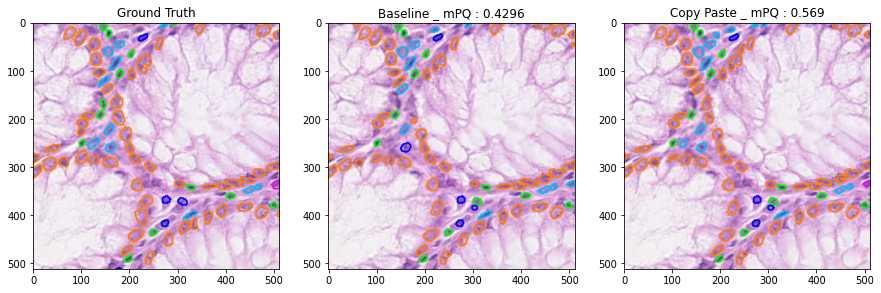

233
[0 2 3 4 5 6]


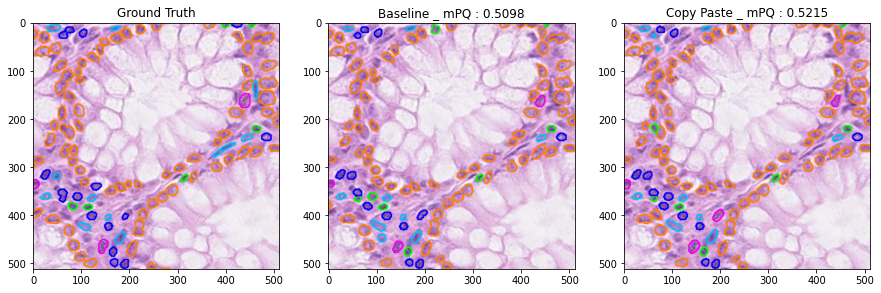

234
[0]


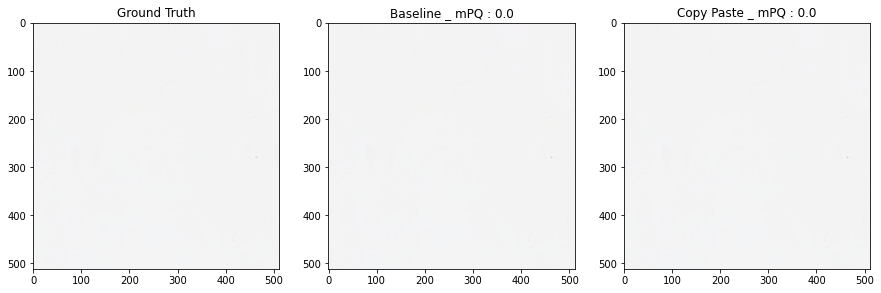

235
[0 3 4 6]


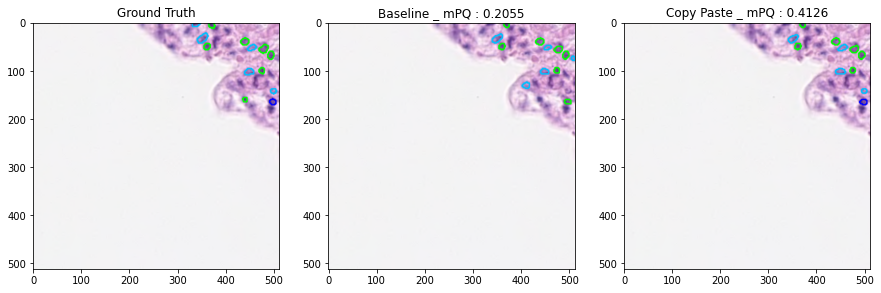

236
[0 2 3 4 6]


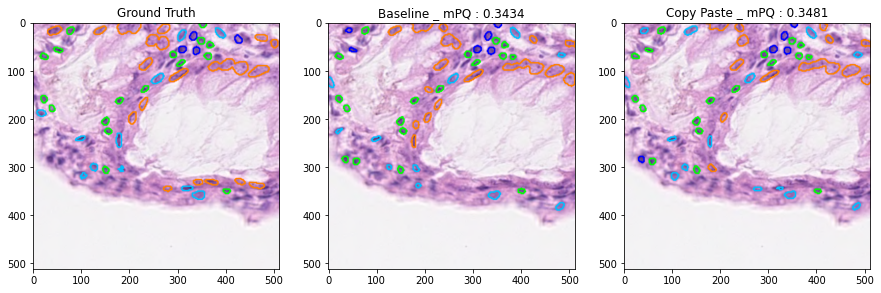

237
[0 2 3 4 5 6]


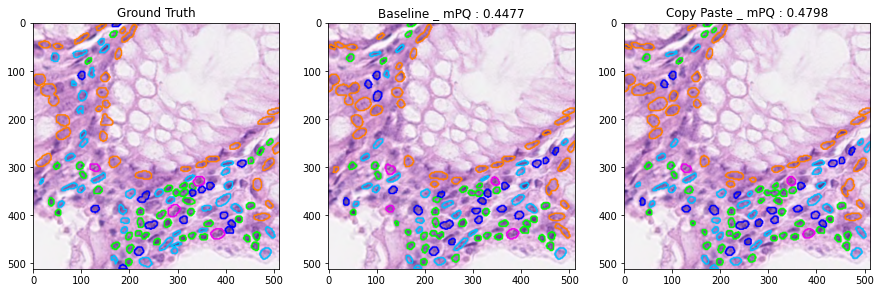

238
[0 2 3 4 5 6]


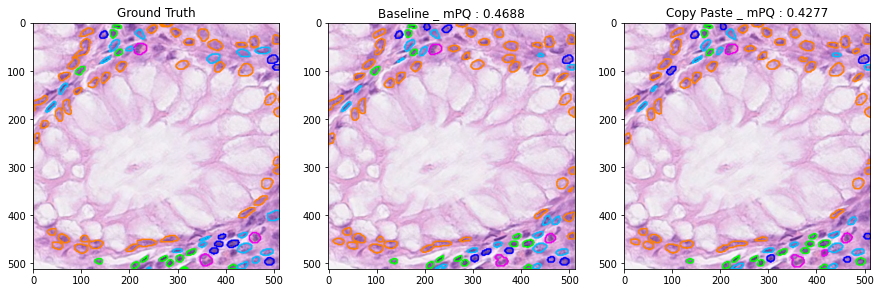

239
[0]


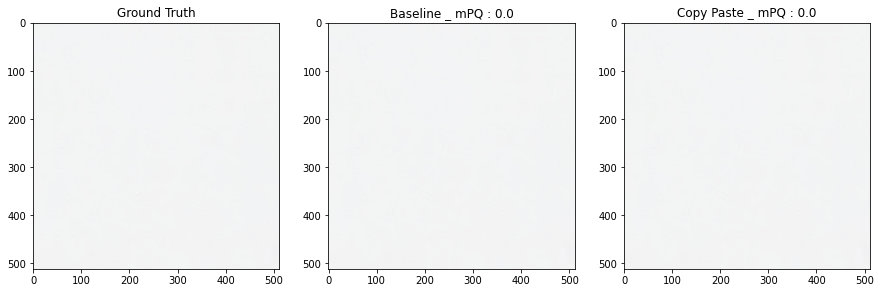

240
[0]


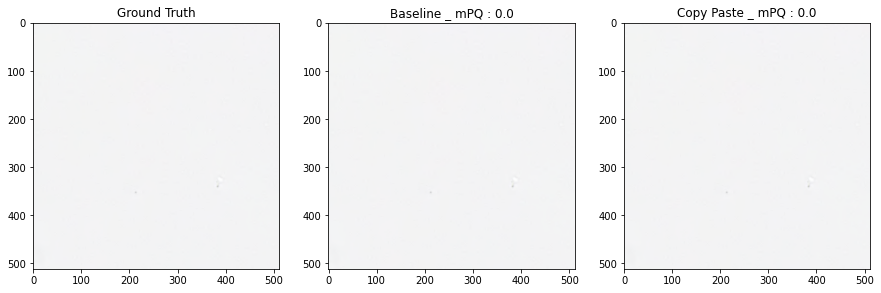

241
[0]


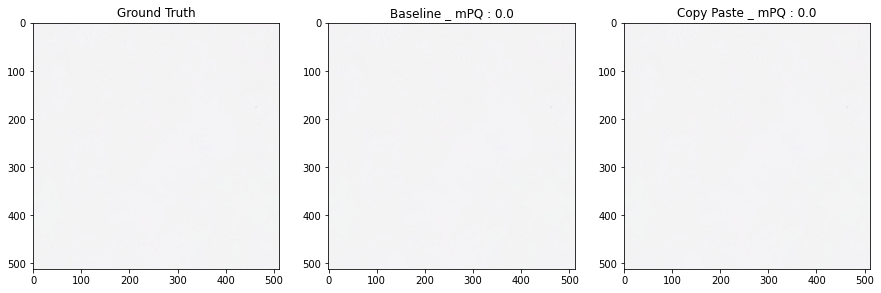

242
[0 2 3 4 6]


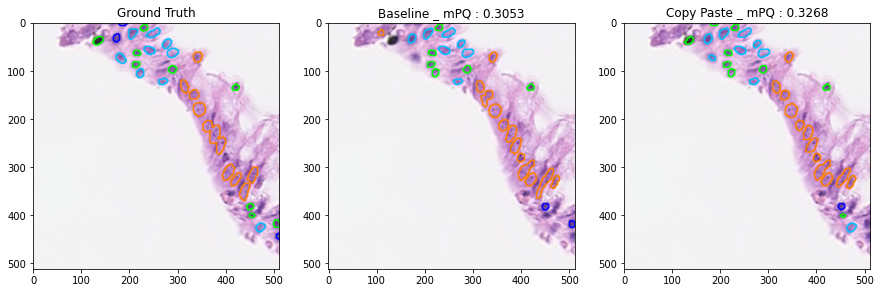

243
[0 2 3 4 5 6]


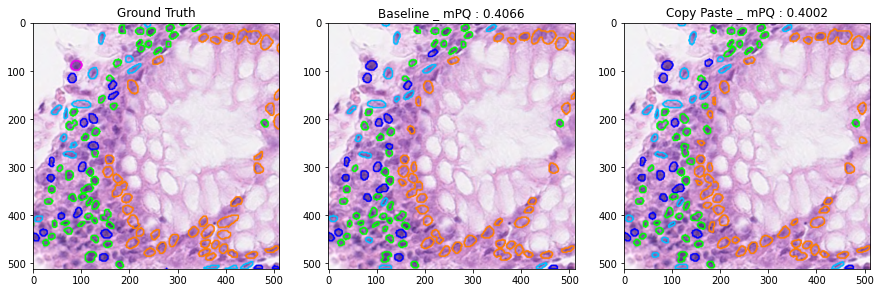

244
[0]


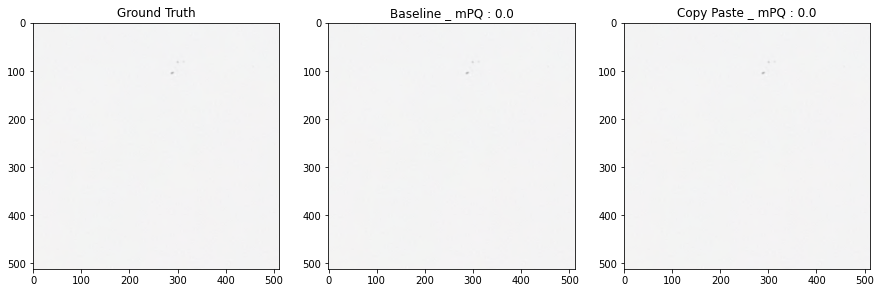

245
[0]


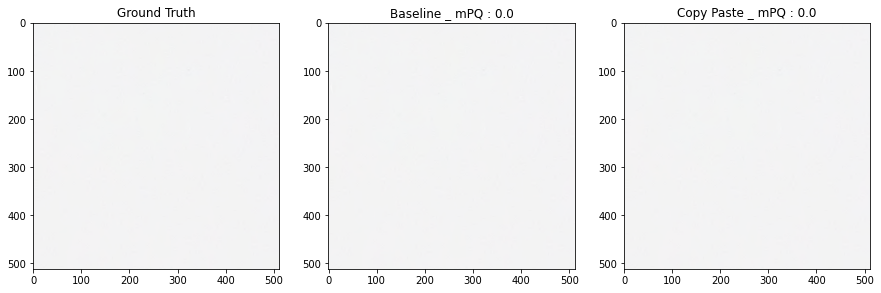

246
[0]


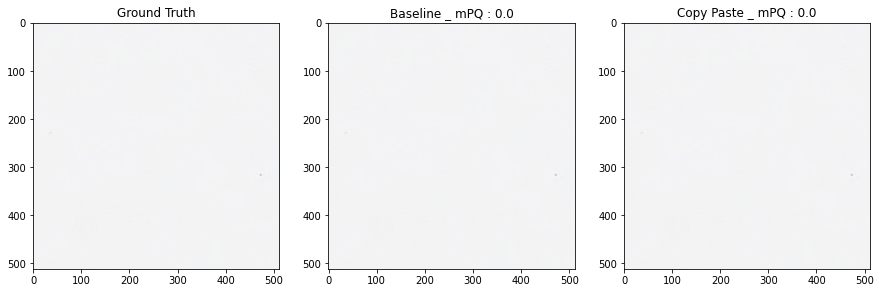

247
[0]


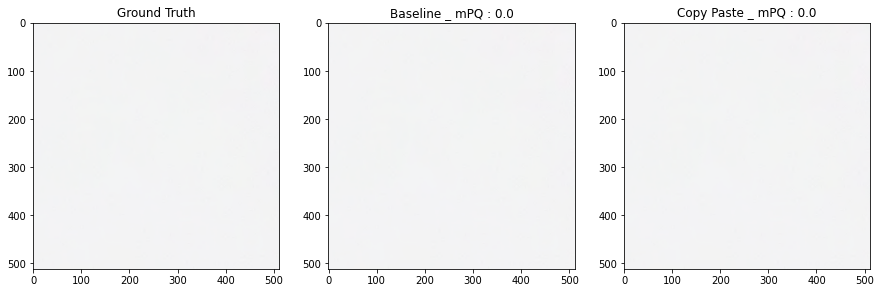

248
[0 2 3 4 5 6]


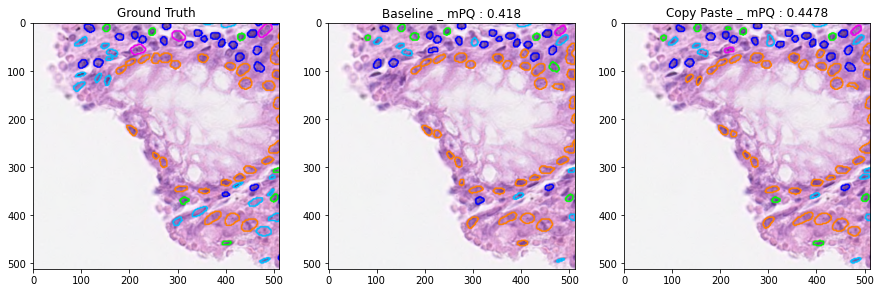

249
[0]


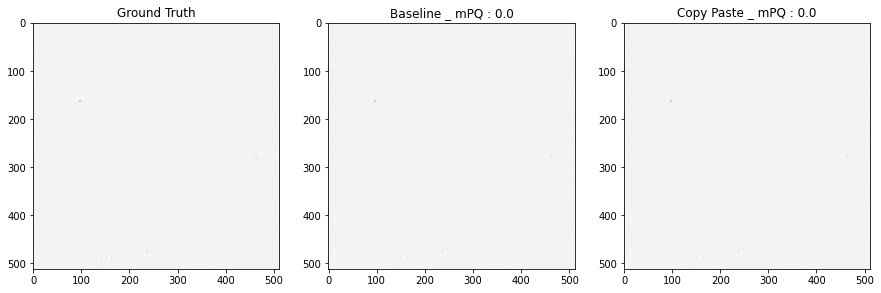

250
[0]


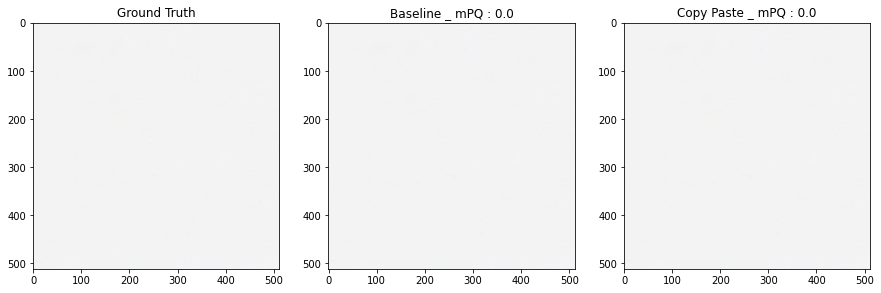

251
[0]


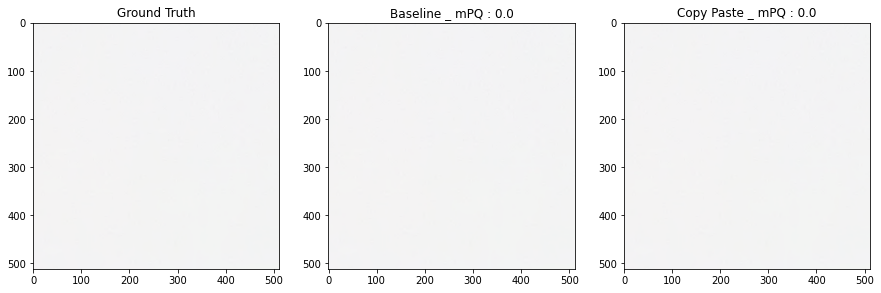

252
[0]


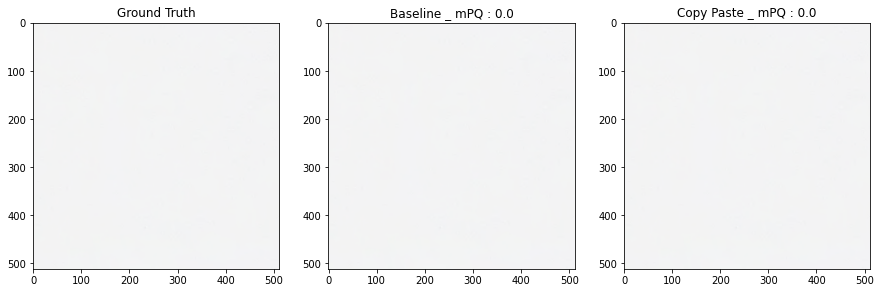

253
[0 6]


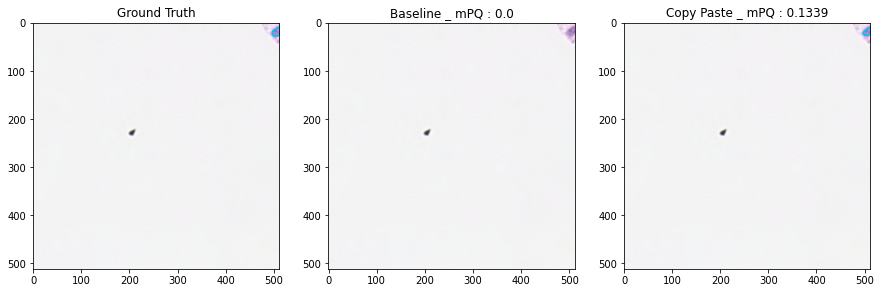

254
[0]


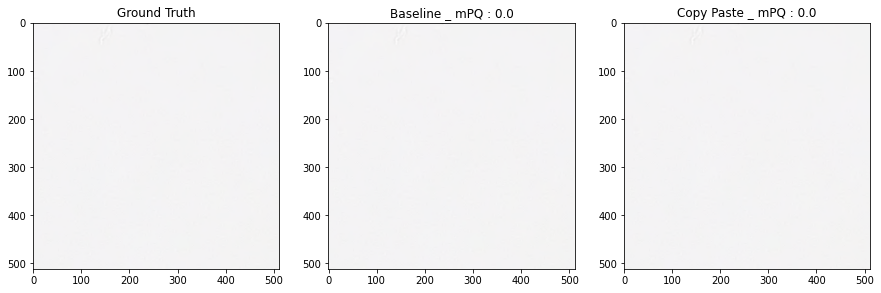

255
[0]


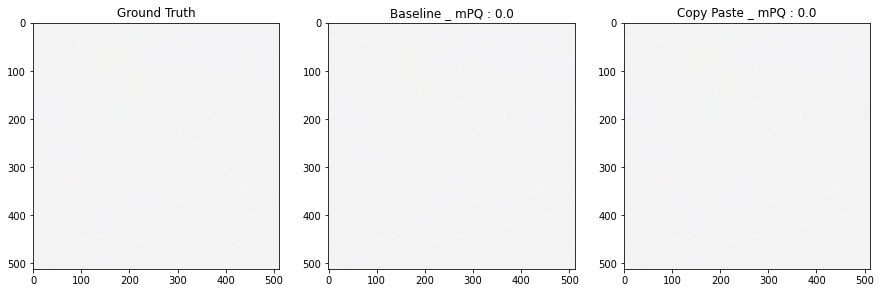

256
[0]


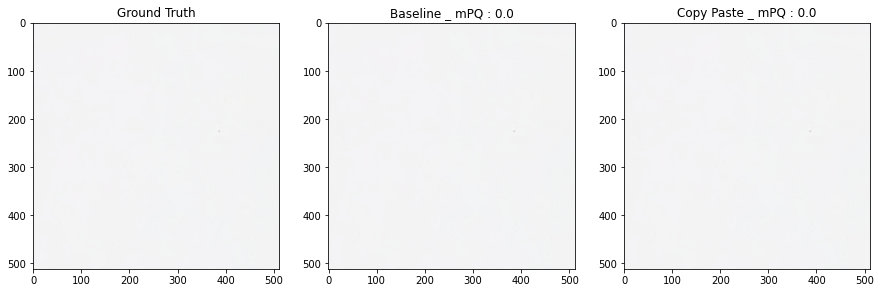

257
[0]


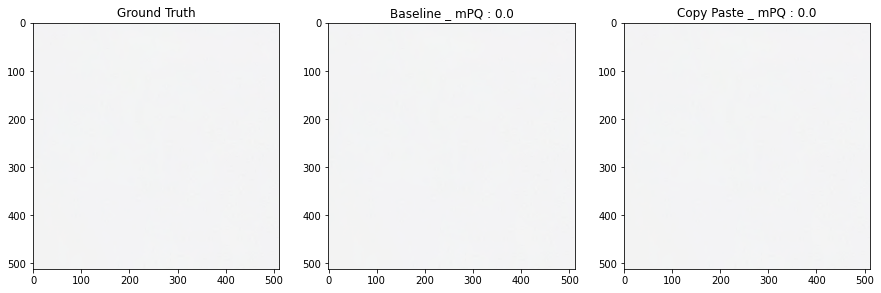

258
[0]


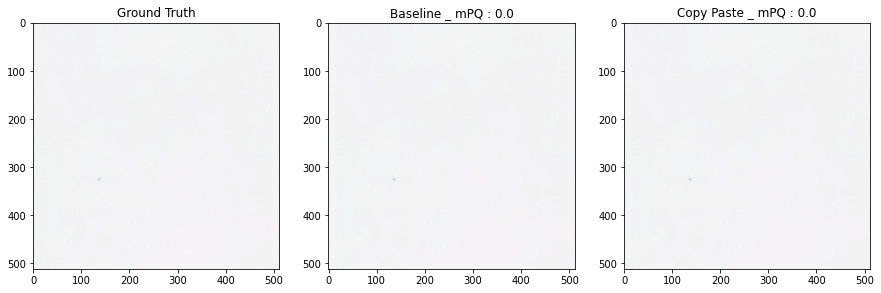

259
[0 2 3 4 5 6]


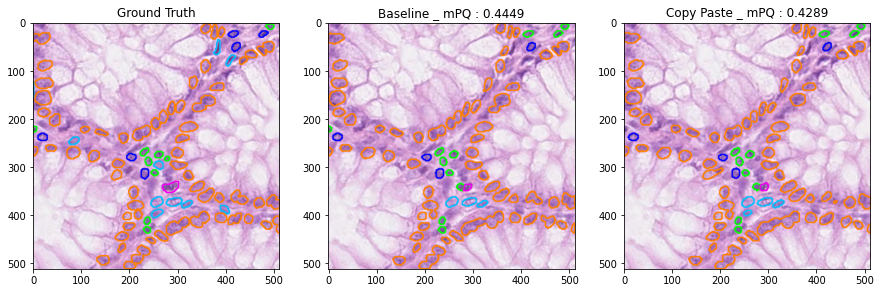

260
[0 2 3 4 5 6]


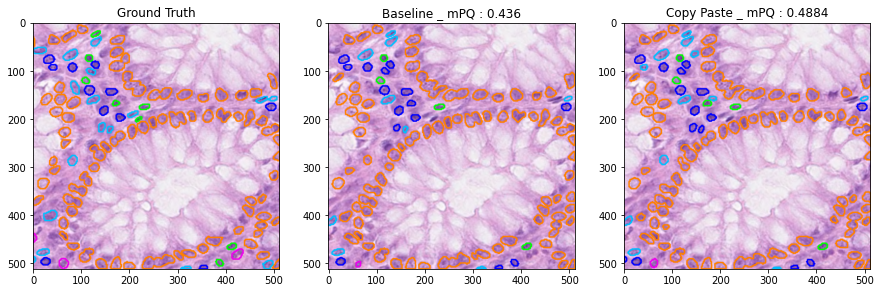

261
[0 2 3 4 6]


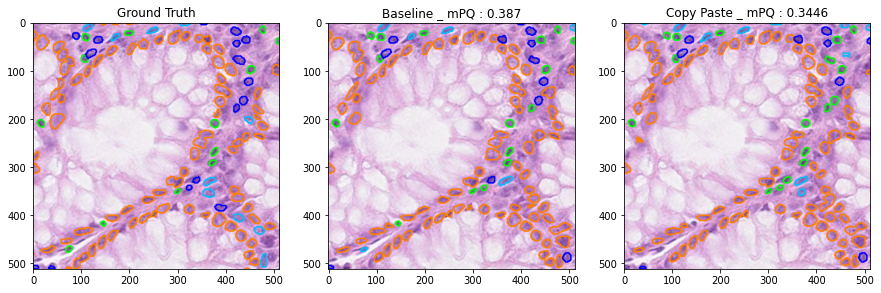

262
[0 2 3 4 5 6]


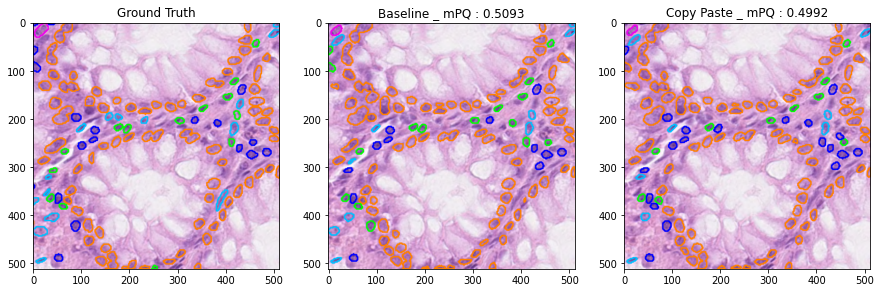

263
[0 1 2 3 5 6]


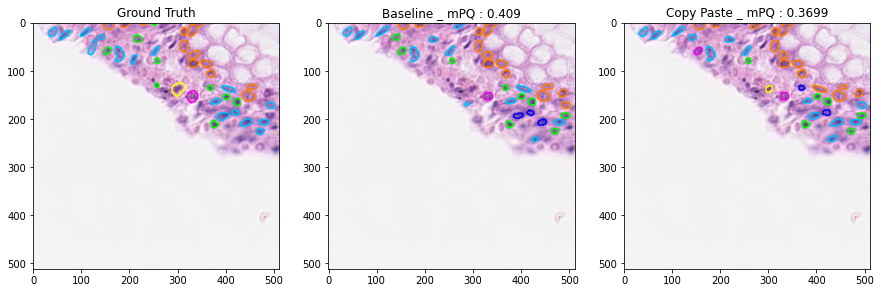

264
[0]


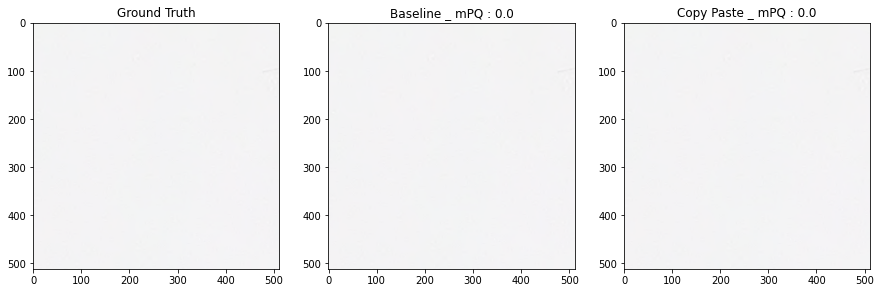

265
[0]


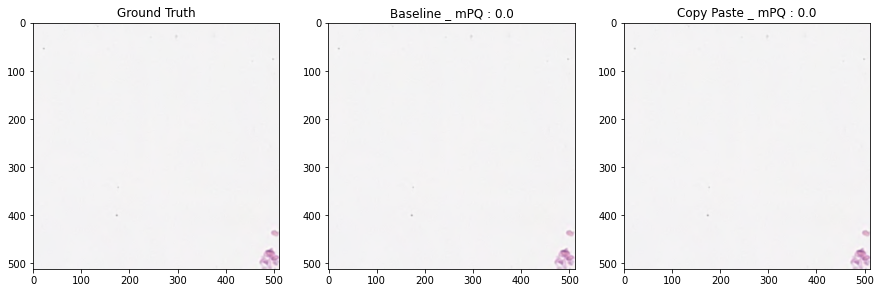

266
[0 2 3 4 6]


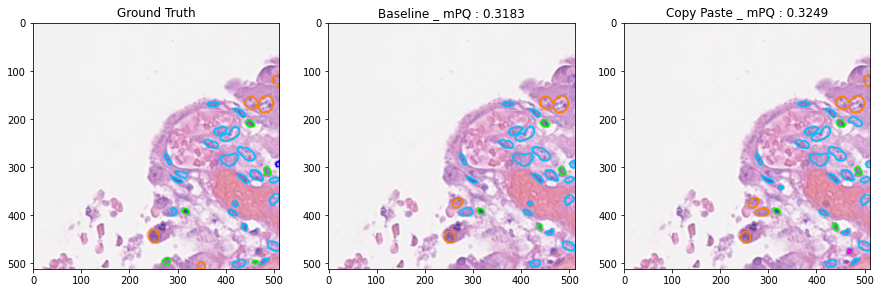

267
[0 2 3 4 6]


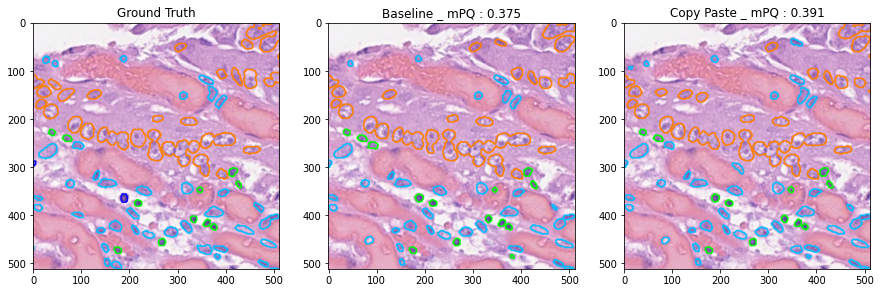

268
[0 2 3 6]


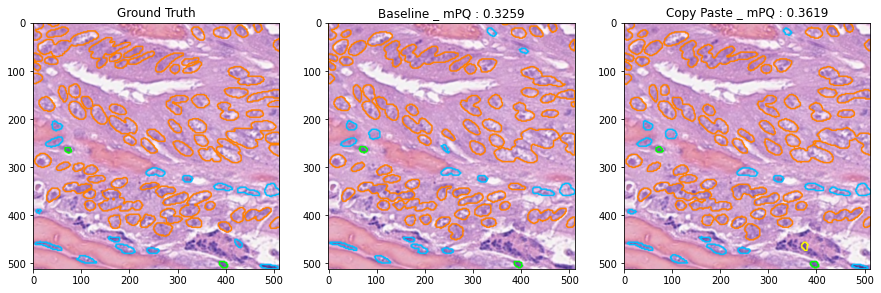

269
[0 2 3 6]


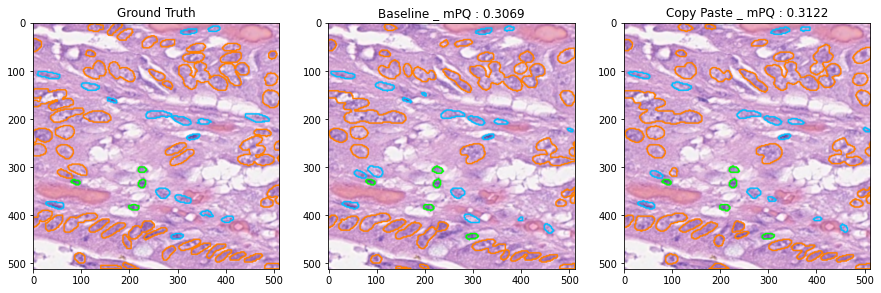

270
[0]


KeyboardInterrupt: 

In [184]:
for i in range(100):
    
    i+=231
    print(i+1)
    
    temp = test_dataset[i]
    image = temp['image']
    print(np.unique(temp['mask']))
    
  

    image = test_dataset[i]['image']
    mask_original = test_dataset[i]['mask'][0].numpy().astype('uint8')
    mask_baseline = pred_final_baseline[i][..., 1].astype('uint8')
    mask_copypaste = pred_final_copypaste[i][..., 1].astype('uint8')

    result_baseilne = compute_pq('seg_class', pred_final_baseline[i][None, ...], gt_final[i][None, ...])
    result_copypaste = compute_pq('seg_class', pred_final_copypaste[i][None, ...], gt_final[i][None, ...])
    mPQ_baseline = np.round(result_baseilne['multi_pq+'][0].mean(), 4)
    mPQ_copypaste = np.round(result_copypaste['multi_pq+'][0].mean(), 4)

    vis = {'0' : (0, 0, 0),
           '1' : (255,255,0),
           '2' : (255,128,0),
           '3' : (0, 255, 0),
           '4' : (0, 0, 255),
           '5' : (238, 0, 238),
           '6' : (0, 191, 255)}

    src_original = (image.permute(1, 2, 0).numpy()*255).astype('uint8').copy()
    src_baseline = (image.permute(1, 2, 0).numpy()*255).astype('uint8').copy()
    src_copypaste = (image.permute(1, 2, 0).numpy()*255).astype('uint8').copy()
    
    resize = True
    if resize:
        src_original = cv2.resize(src_original, None, fx=2, fy=2)
        mask_original = cv2.resize(mask_original, None, fx=2, fy=2, interpolation = cv2.INTER_NEAREST)        
        
        src_baseline = cv2.resize(src_baseline, None, fx=2, fy=2)
        mask_baseline = cv2.resize(mask_baseline, None, fx=2, fy=2, interpolation = cv2.INTER_NEAREST)
        
        src_copypaste = cv2.resize(src_copypaste, None, fx=2, fy=2)
        mask_copypaste = cv2.resize(mask_copypaste, None, fx=2, fy=2, interpolation = cv2.INTER_NEAREST)
        
        
    for c in np.unique(mask_original)[1:]:
        contours, hierarchy = cv2.findContours((mask_original == c).astype('uint8'), cv2.RETR_CCOMP, cv2.CHAIN_APPROX_NONE)
        for i in range(len(contours)):
            cv2.drawContours(src_original, [contours[i]], 0, vis['{}'.format(c)], 2)          
        

    for c in np.unique(mask_baseline)[1:]:
        contours, hierarchy = cv2.findContours((mask_baseline == c).astype('uint8'), cv2.RETR_CCOMP, cv2.CHAIN_APPROX_NONE)
        for i in range(len(contours)):
            cv2.drawContours(src_baseline, [contours[i]], 0, vis['{}'.format(c)], 2)    
    
    
    for c in np.unique(mask_copypaste)[1:]:
        contours, hierarchy = cv2.findContours((mask_copypaste == c).astype('uint8'), cv2.RETR_CCOMP, cv2.CHAIN_APPROX_NONE)
        for i in range(len(contours)):
            cv2.drawContours(src_copypaste, [contours[i]], 0, vis['{}'.format(c)], 2)        
    
    
    
    plt.figure(figsize=(15, 15))
    
    plt.subplot(1, 3, 1)
    plt.imshow(src_original)
    plt.title("Ground Truth")
    
    plt.subplot(1, 3, 2)
    plt.imshow(src_baseline)
    plt.title("Baseline _ mPQ : {}".format(mPQ_baseline))
    
    plt.subplot(1, 3, 3)
    plt.imshow(src_copypaste)
    plt.title("Copy Paste _ mPQ : {}".format(mPQ_copypaste))
    
    plt.show() 

In [ ]:
    vis = {'0' : (0, 0, 0),
           '1' : (255,255,0),
           '2' : (255,128,0),
           '3' : (0, 255, 0),
           '4' : (0, 0, 255),
           '5' : (238, 0, 238),
           '6' : (0, 191, 255)}

921
[0 2 3 4 5 6]


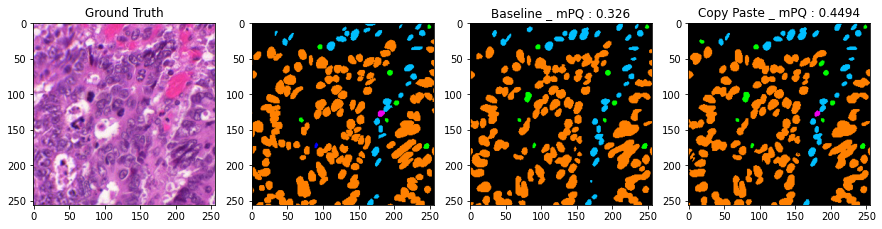

922
[0 2 3 4 6]


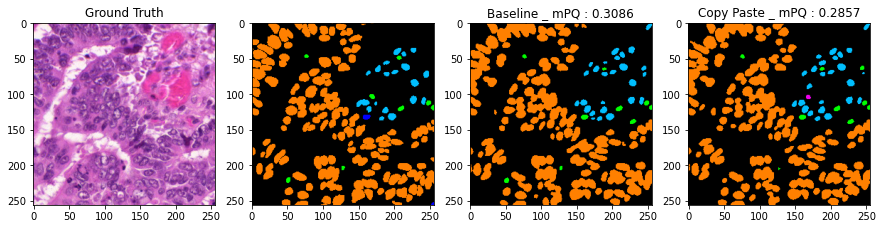

923
[0 2 3 4 6]


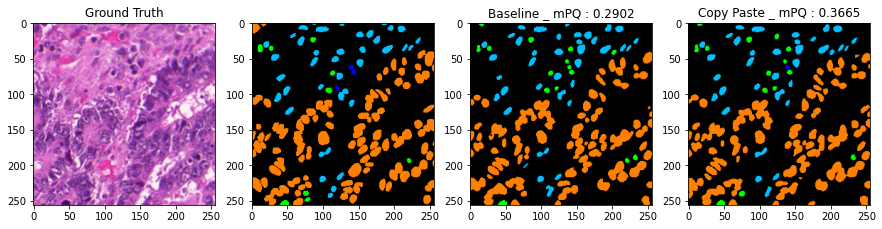

924
[0 2 3 4 5 6]


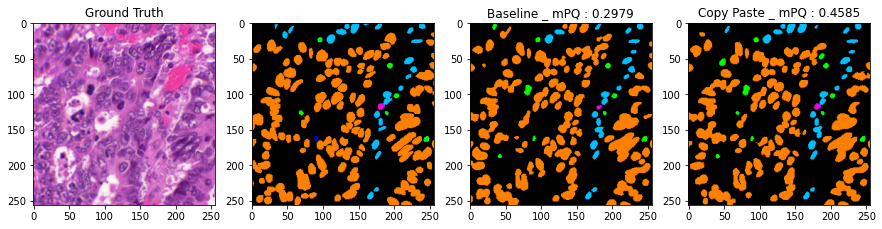

925
[0 2 3 4 6]


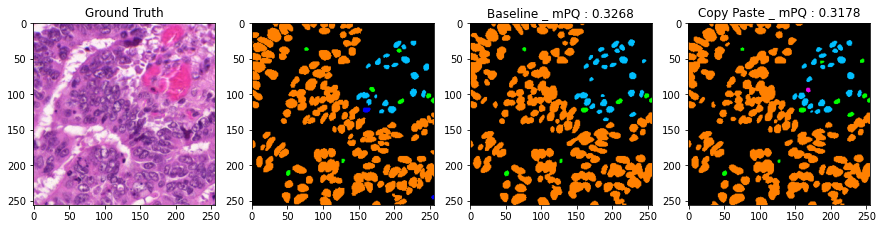

926
[0 2 3 4 5 6]


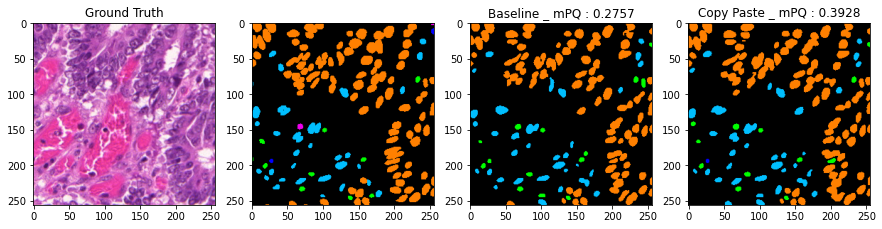

927
[0 2 3 4 6]


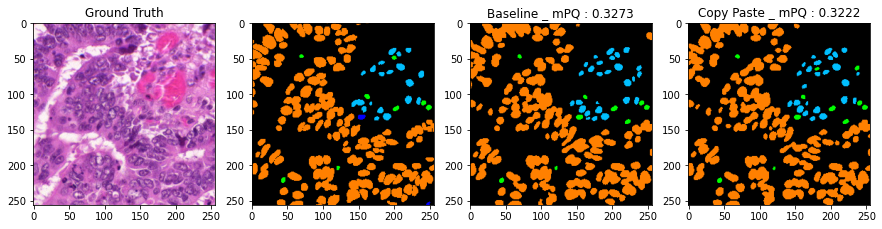

928
[0 2 3 4 6]


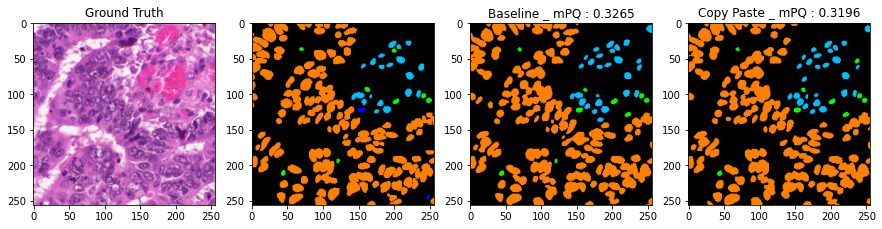

929
[0 1 2 3 4 5 6]


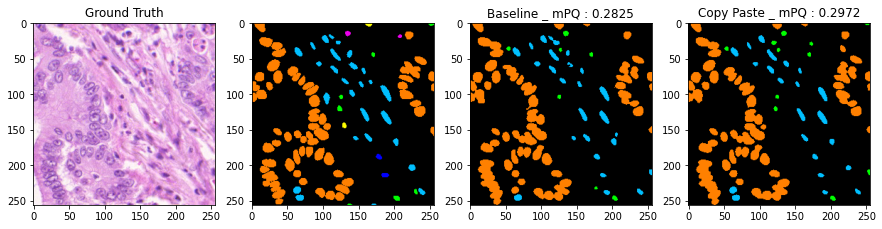

930
[0 1 2 3 5 6]


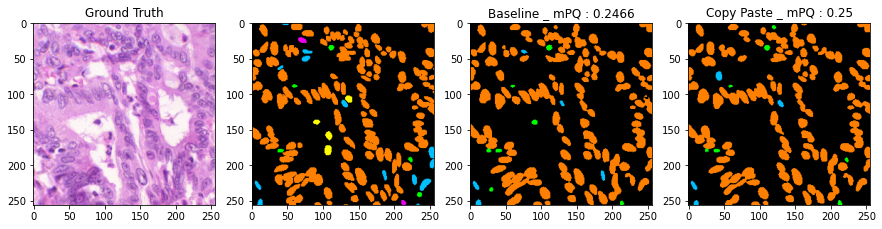

931
[0 1 2 3 4 5 6]


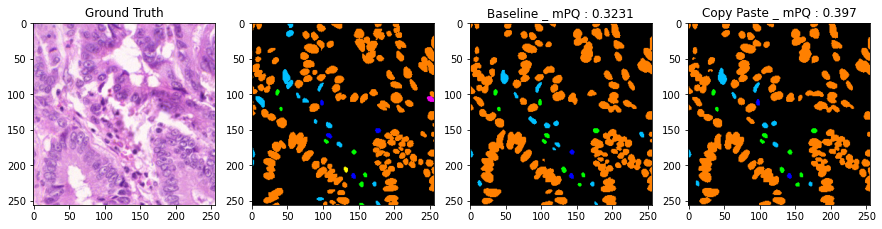

932
[0 1 2 3 4 5 6]


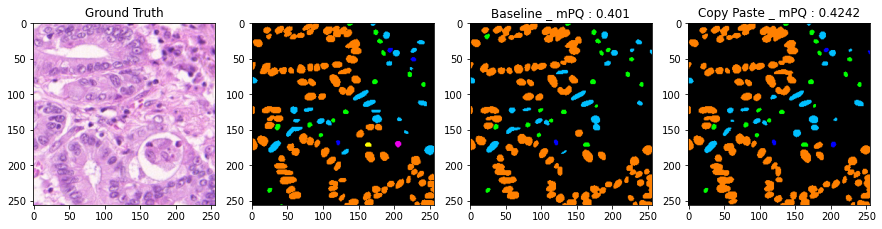

933
[0 1 2 3 4 5 6]


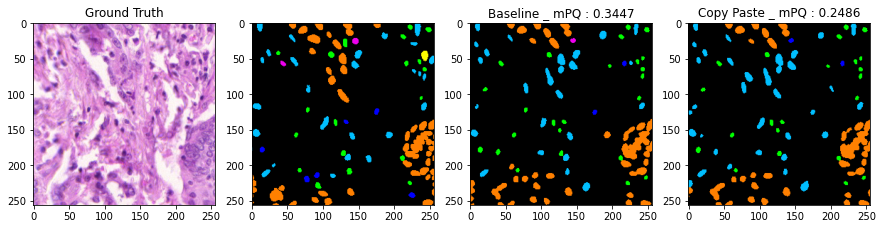

934
[0 2 3 6]


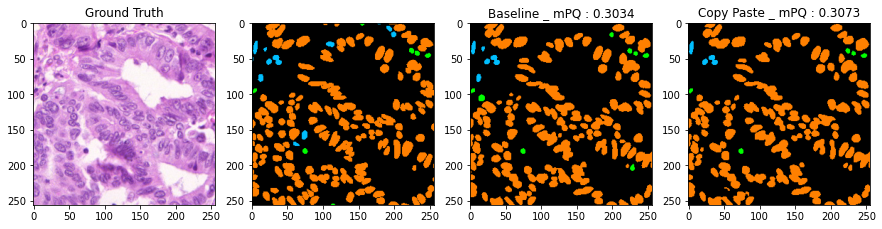

935
[0 1 2 3 4 5 6]


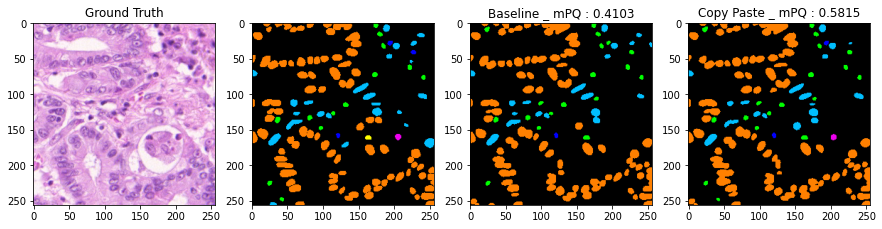

936
[0 1 2 3 4 5 6]


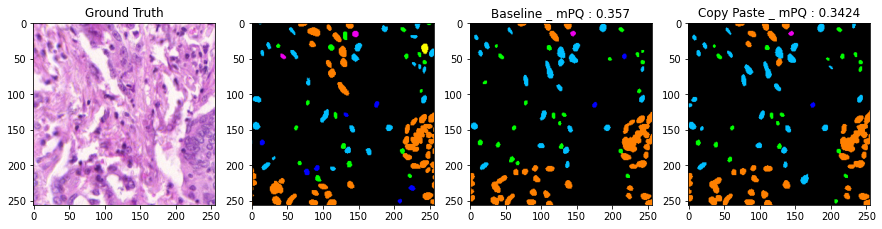

937
[0 2 3 6]


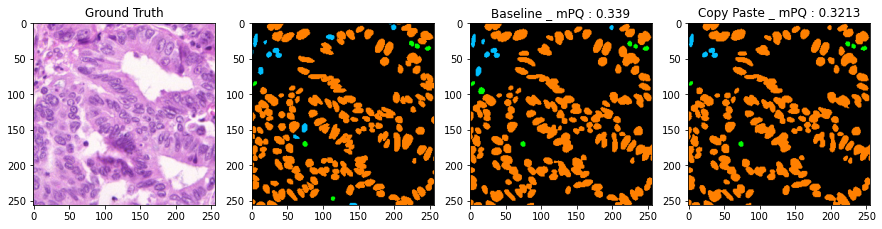

938
[0 1 2 3 4 5 6]


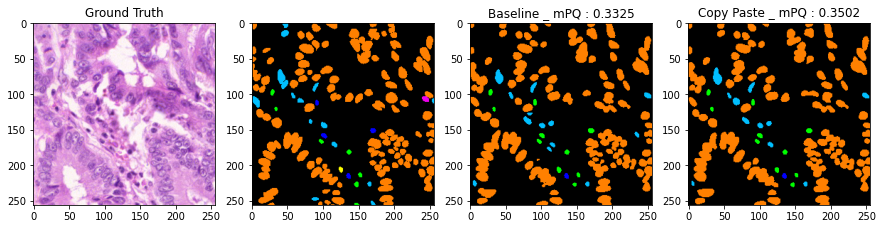

939
[0 2 3 6]


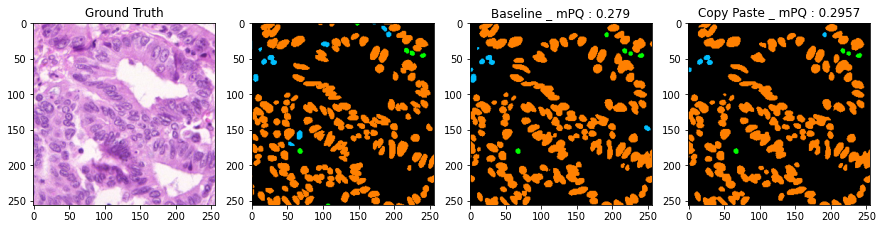

940
[0 2 3 6]


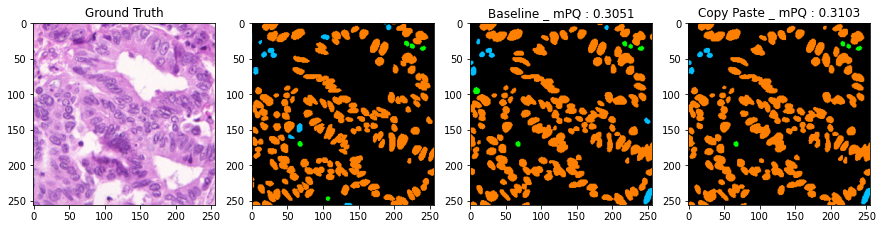

941
[0 2 3 6]


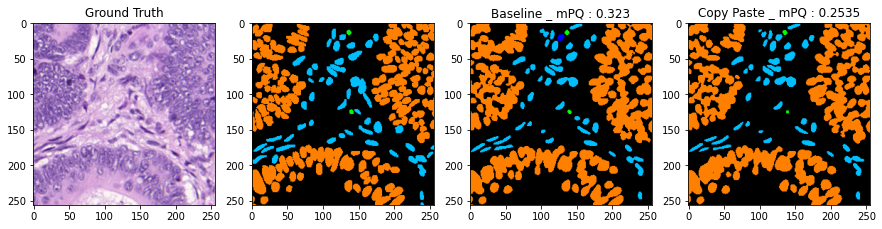

942
[0 2 3 4 6]


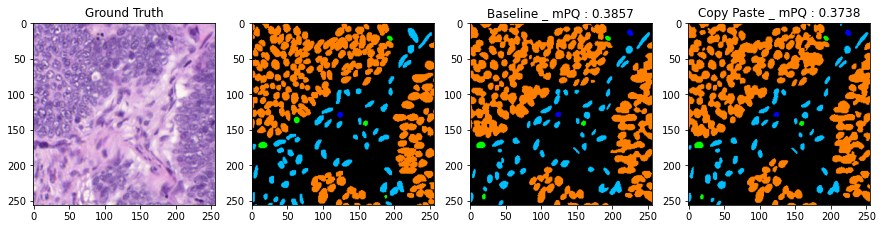

943
[0 2 3 6]


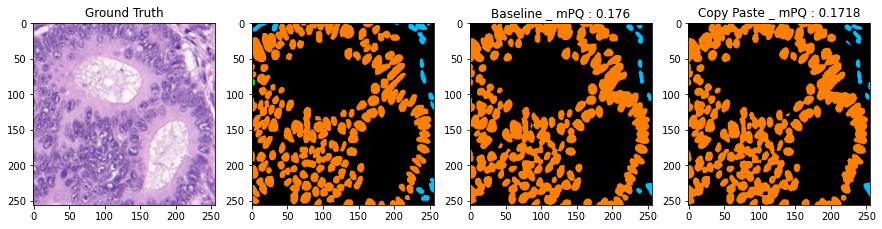

944
[0 2 3 5 6]


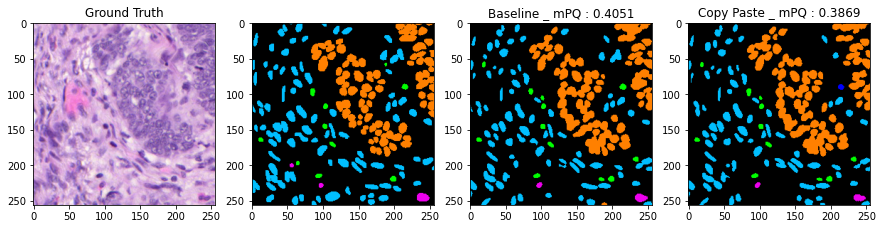

945
[0 2 3 4 6]


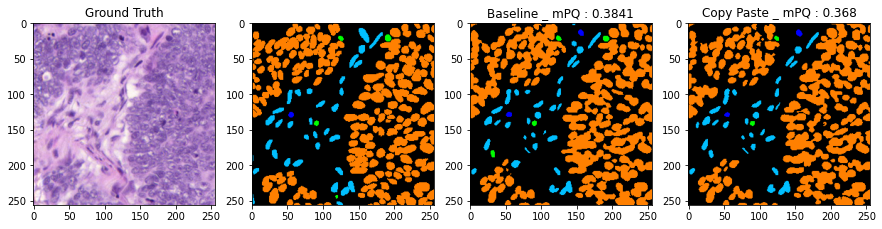

946
[0 2 3 4 5 6]


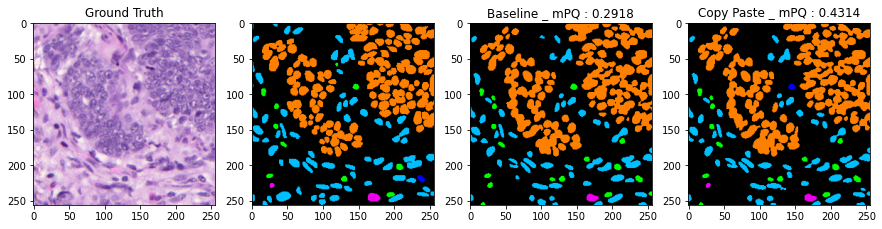

947
[0 1 2 3 4 6]


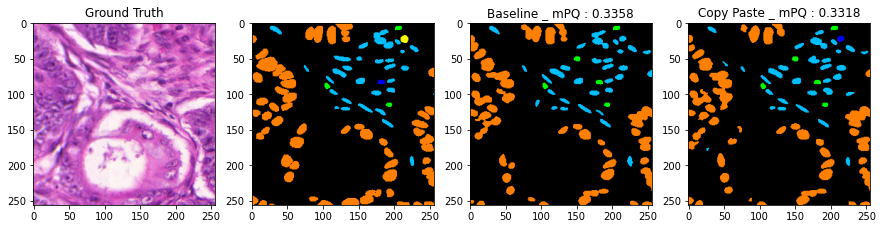

948
[0 2 3 4 6]


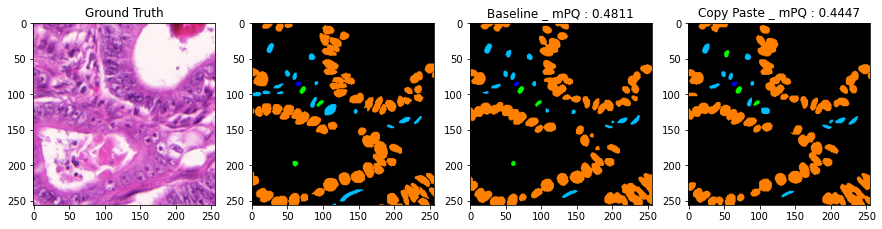

949
[0 2 3 6]


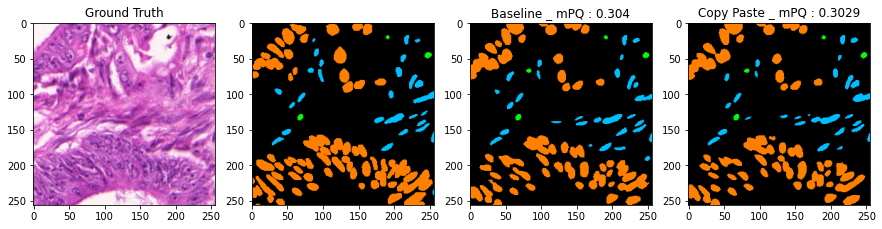

950
[0 2 6]


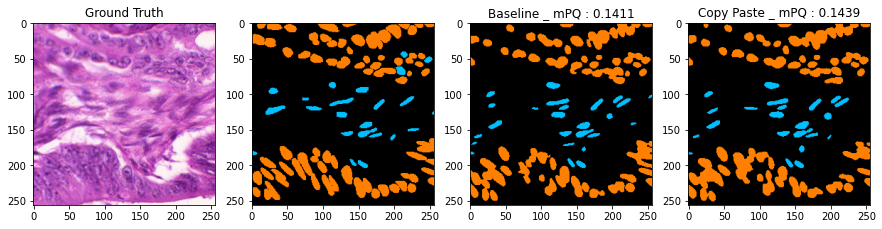

951
[0 2 6]


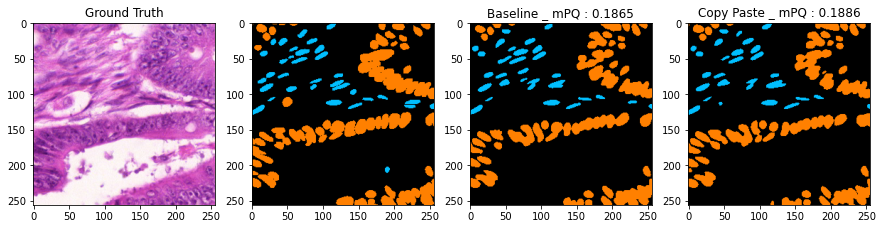

952
[0 2 6]


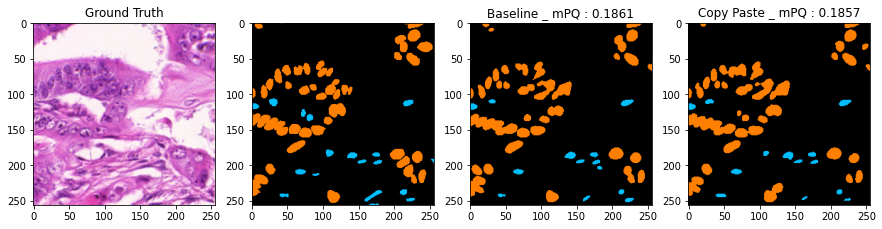

953
[0 2 6]


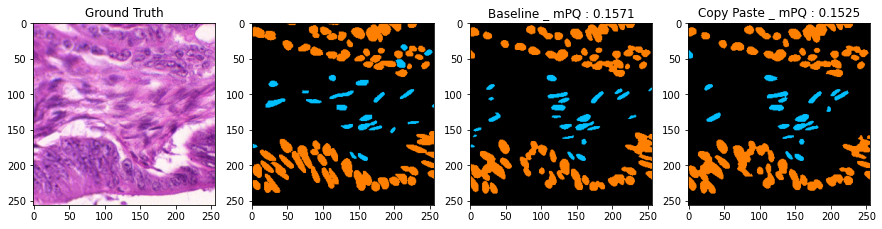

954
[0 2 6]


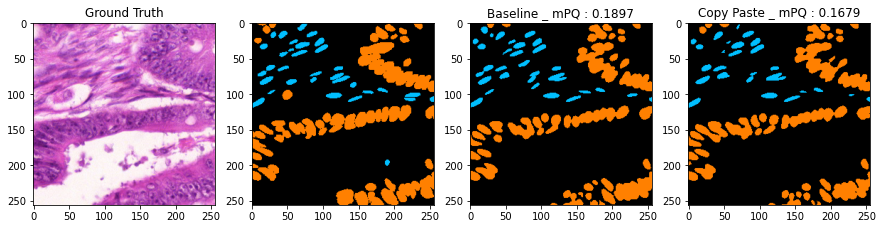

955
[0 2 6]


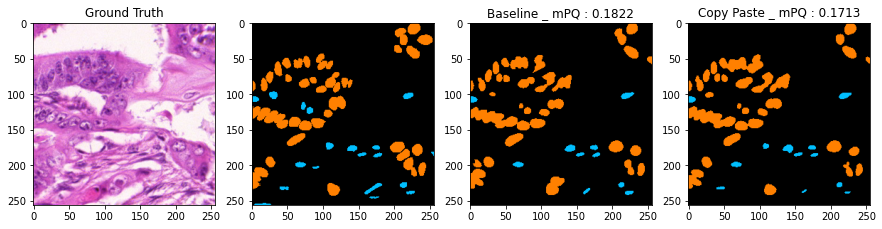

956
[0 2 3 6]


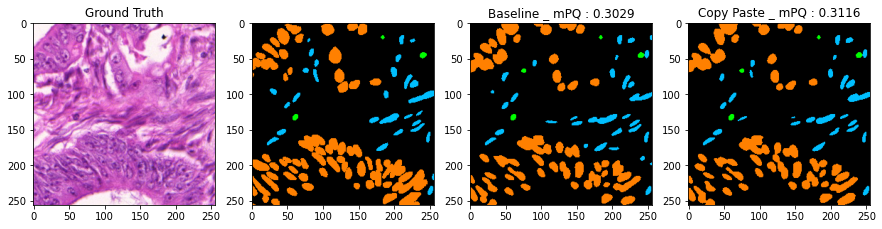

957
[0 2 3 6]


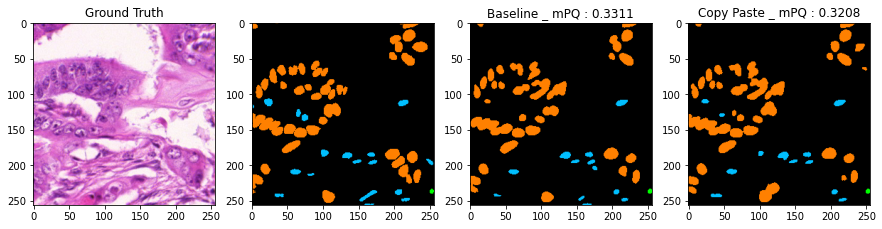

958
[0 2 3 6]


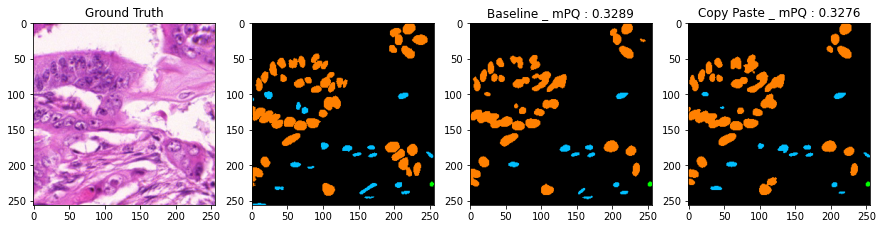

959
[0 2 3 4 5 6]


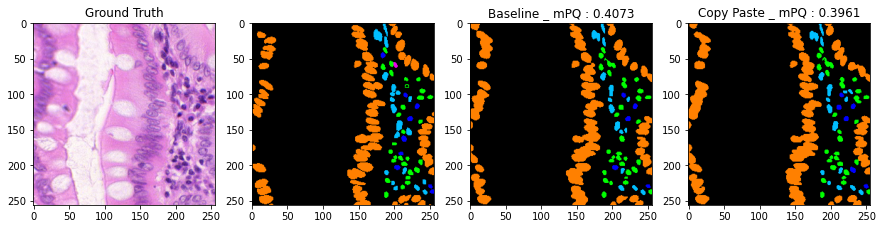

960
[0 2 3 4 5 6]


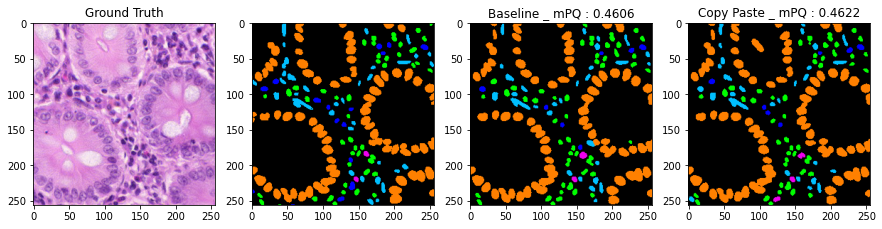

961
[0 2 3 4 5 6]


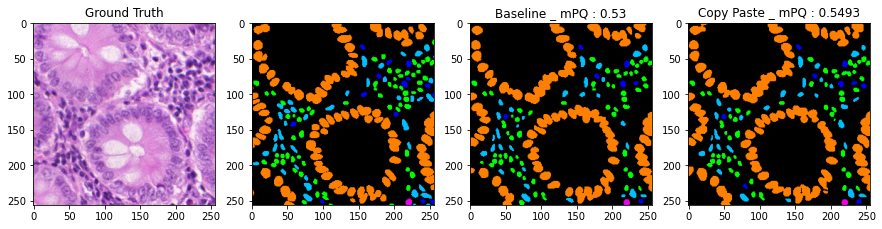

962
[0 2 3 4 6]


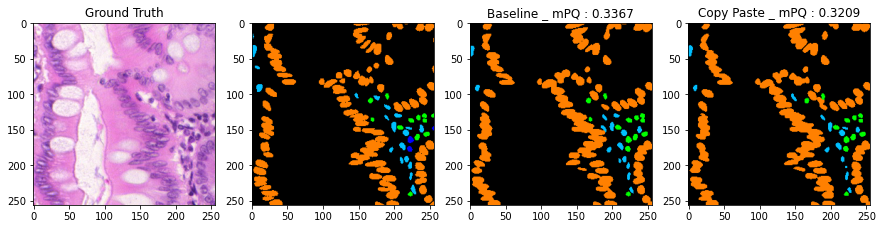

963
[0 2 3 4 6]


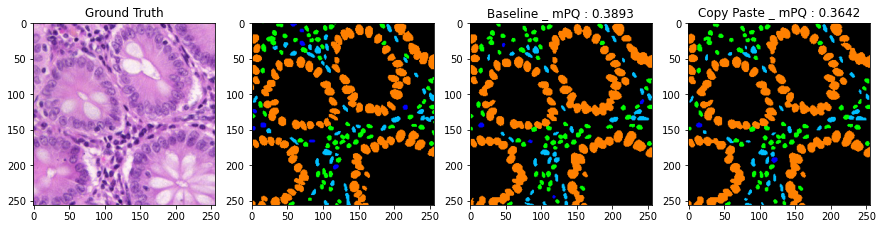

964
[0 2 3 4 5 6]


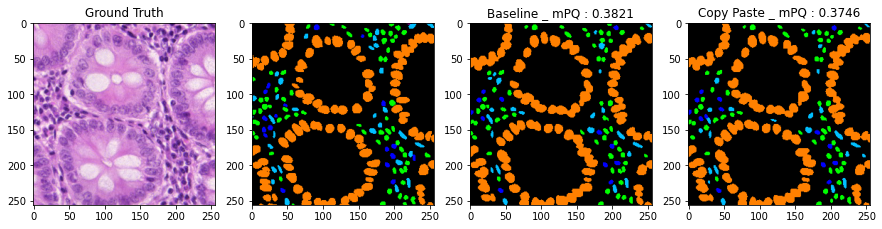

965
[0 2 3 4 6]


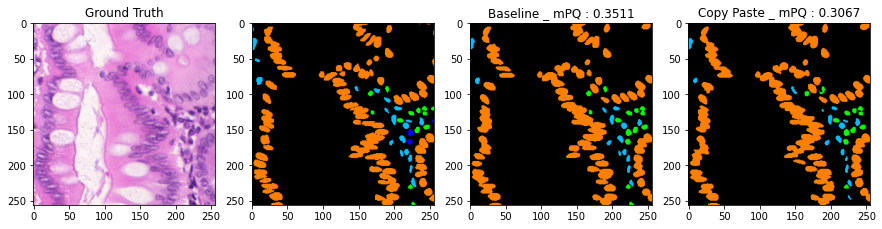

966
[0 2 3 4 6]


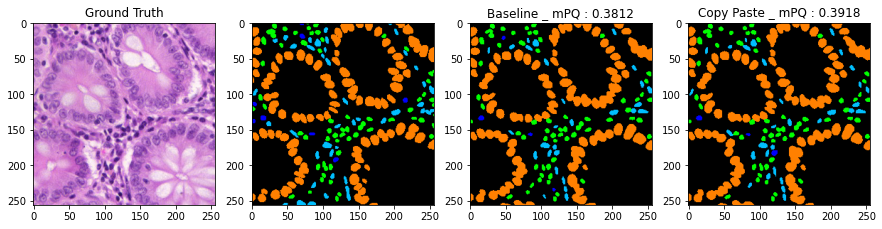

967
[0 2 3 4 6]


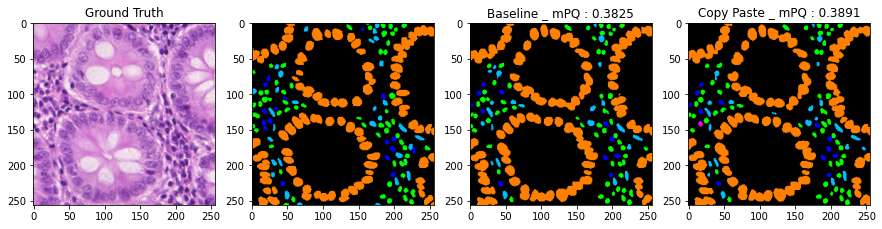

968
[0 2 3 4 5 6]


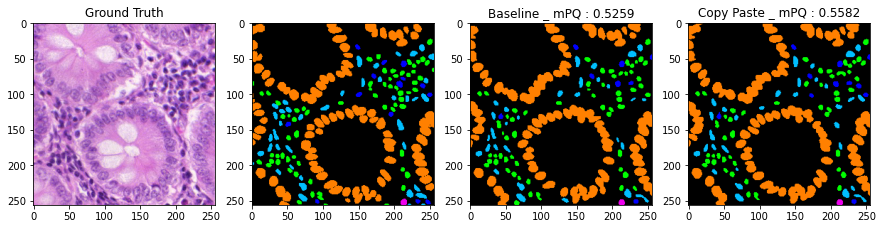

969
[0 2 3 4 5 6]


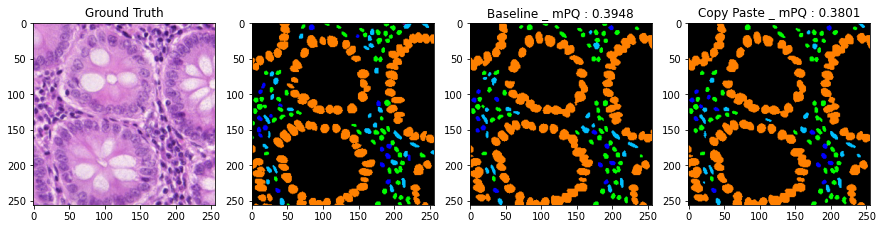

970
[0 2 3 4 6]


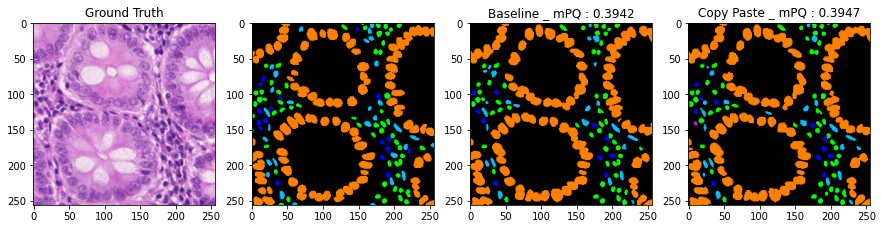

971
[0 1 2 3 6]


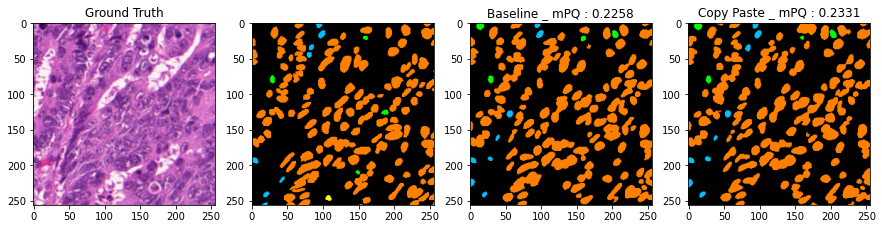

972
[0 2 3 4 6]


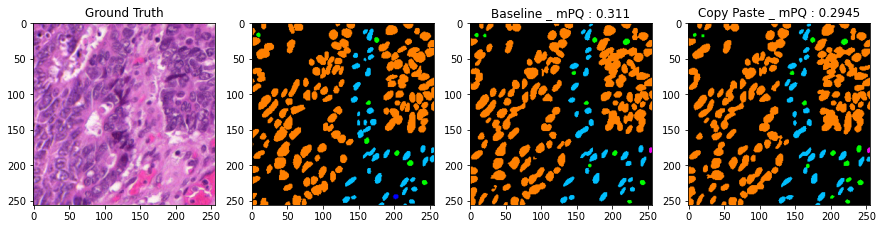

973
[0 1 2 3 6]


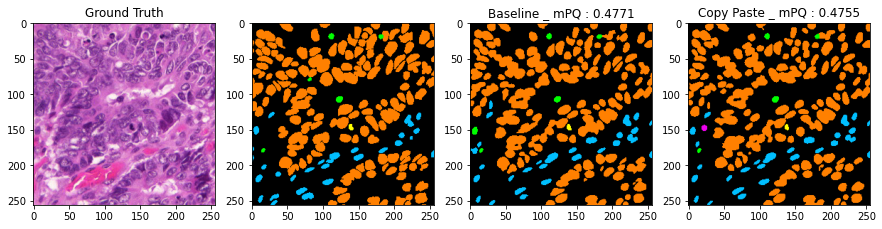

974
[0 2 3 6]


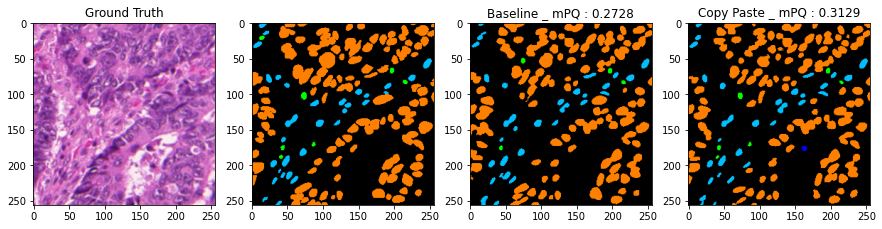

975
[0 2 3 4 6]


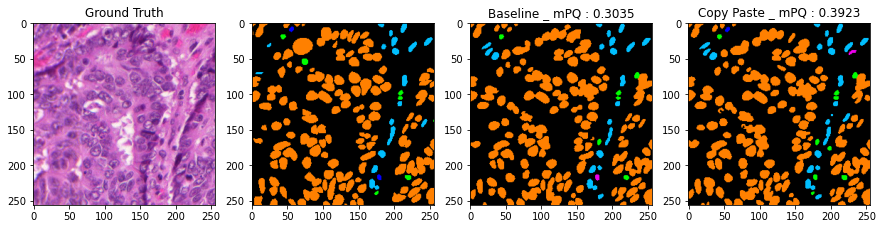

976
[0 2 3 6]


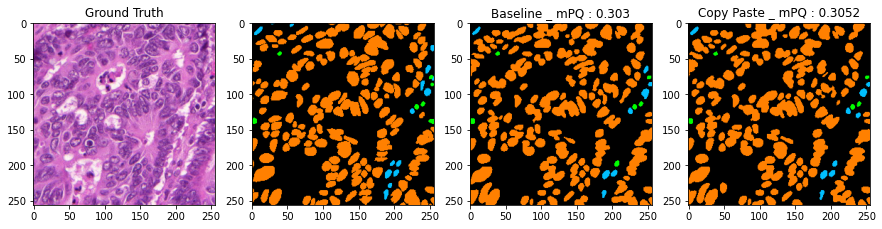

977
[0 2 3 6]


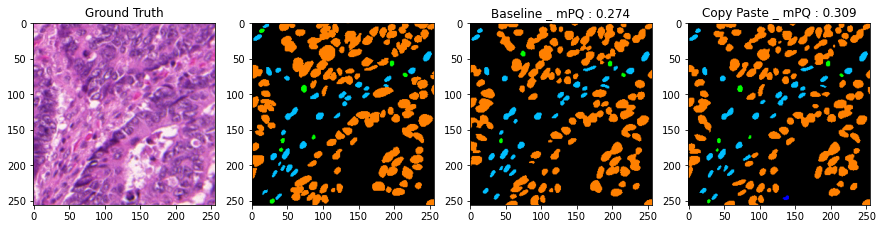

978
[0 2 3 4 6]


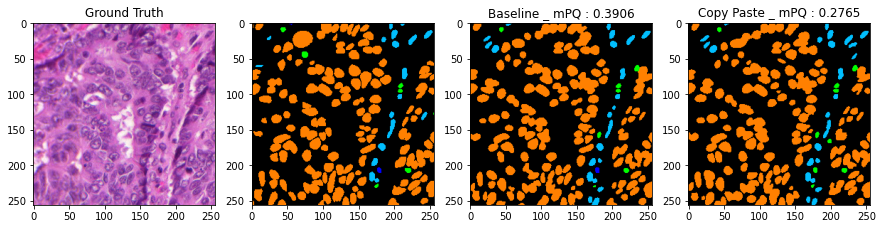

979
[0 2 3 6]


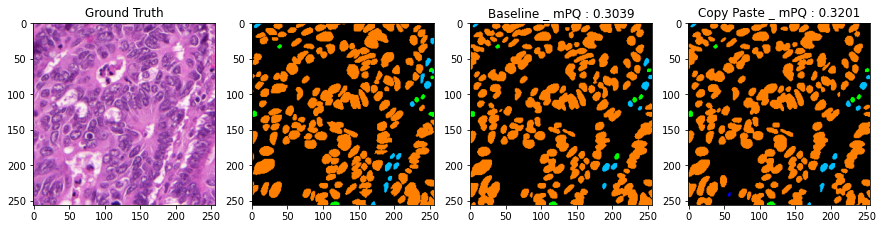

980
[0 1 2 3 6]


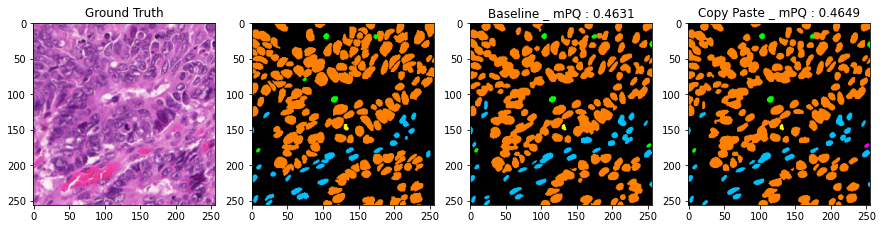

981
[0 2 3 6]


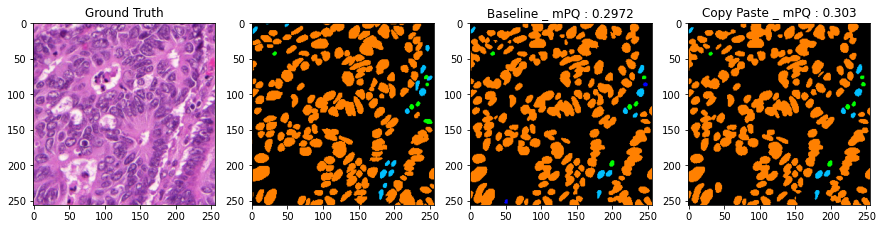

982
[0 2 3 6]


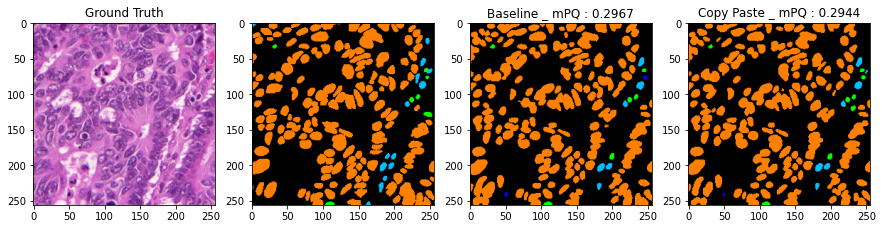

983
[0 2 3 6]


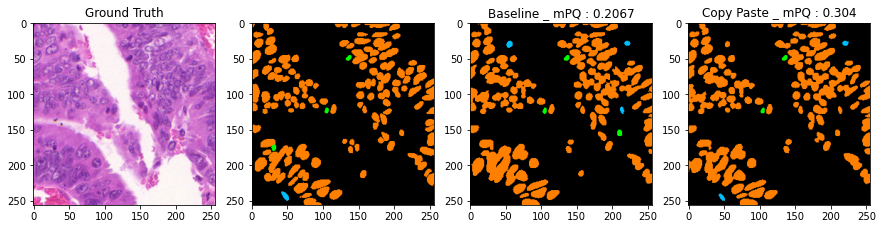

984
[0 2 3 4 6]


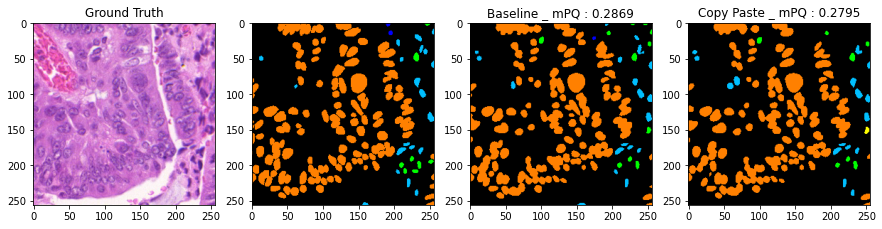

985
[0 2 3 4 6]


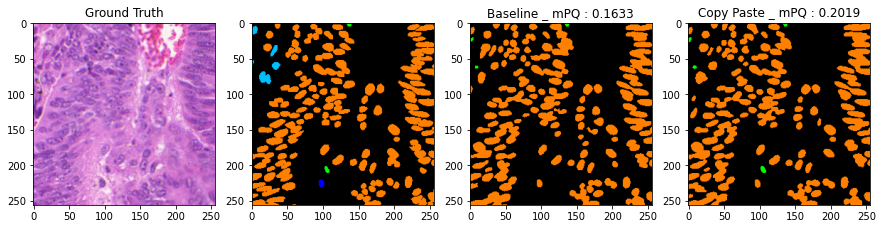

986
[0 2 3 6]


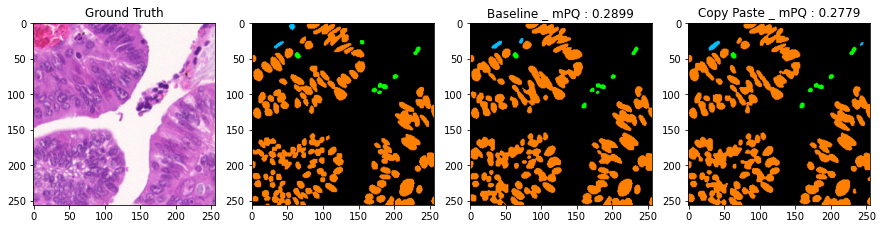

987
[0 2 3 6]


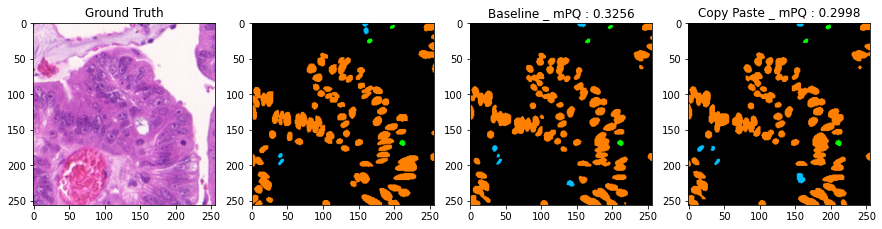

988
[0 2 3 6]


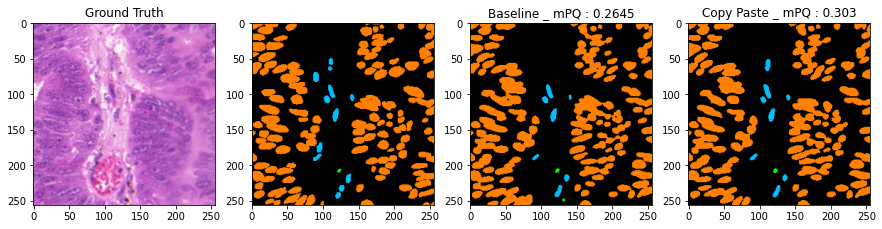

989
[0 2 3 6]


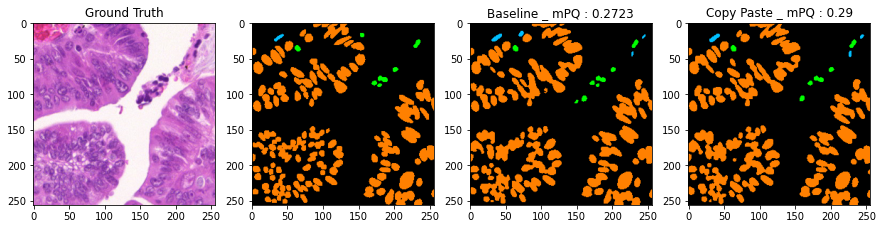

990
[0 2 3 6]


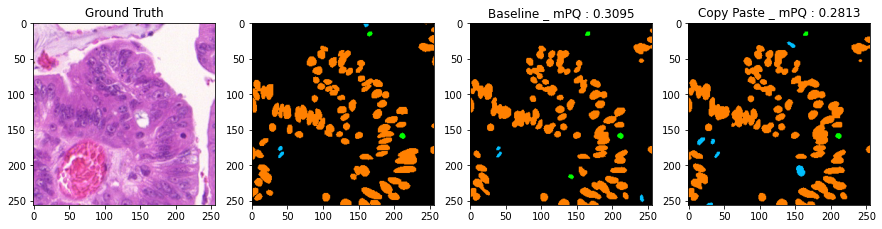

991
[0 2 3 6]


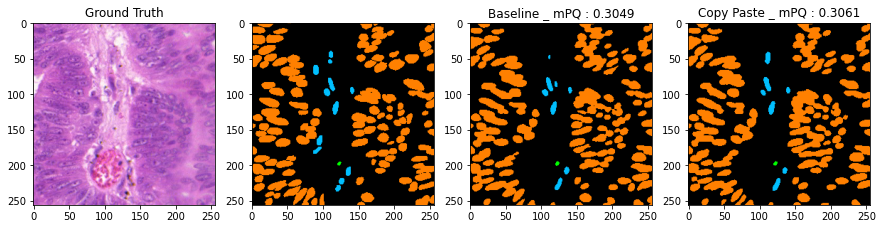

992
[0 2 3 4 6]


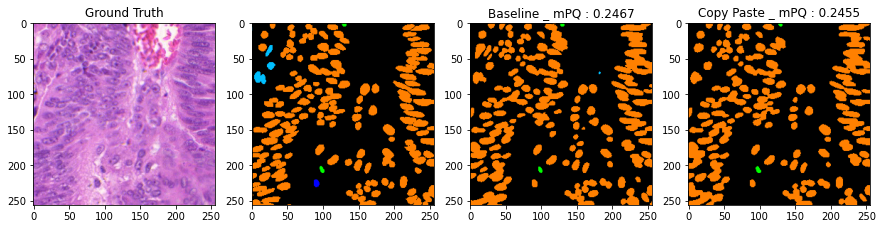

993
[0 2 3 6]


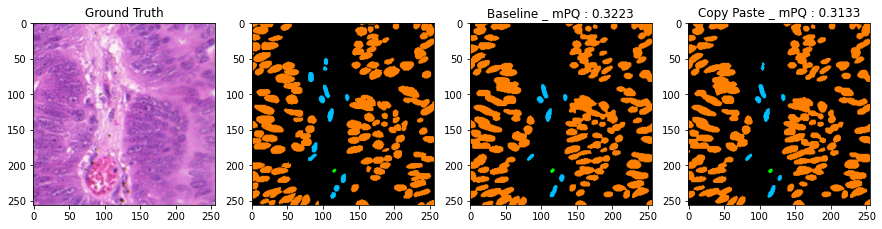

994
[0 2 3 6]


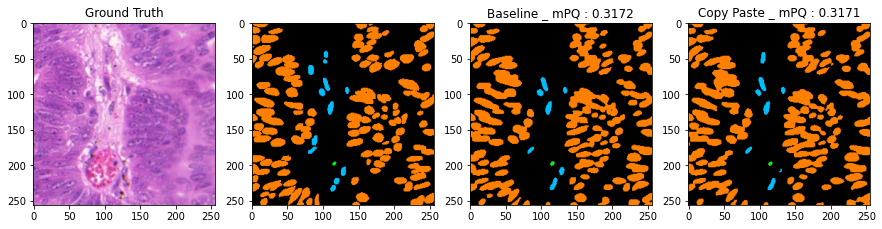

995
[0 3 4 6]


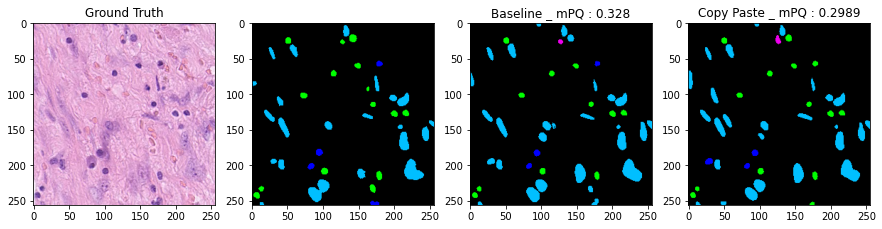

996
[0 3 4 6]


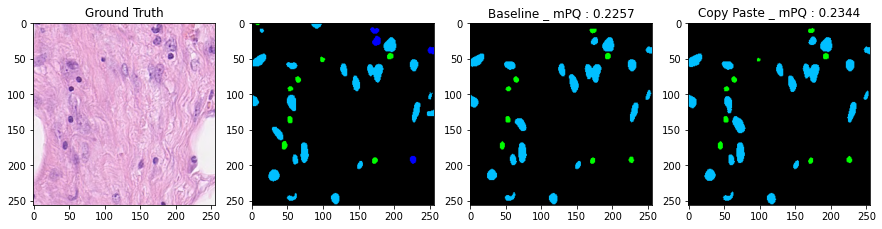

997
[0 3 4 6]


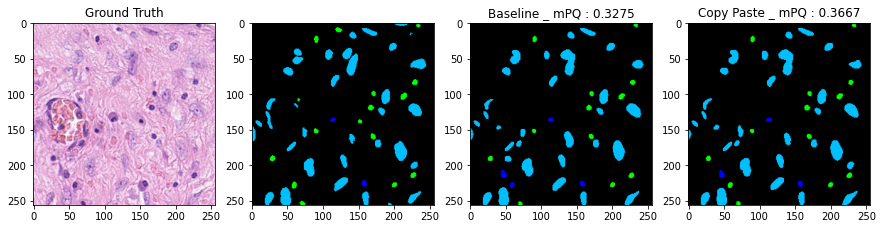

998
[0 3 4 6]


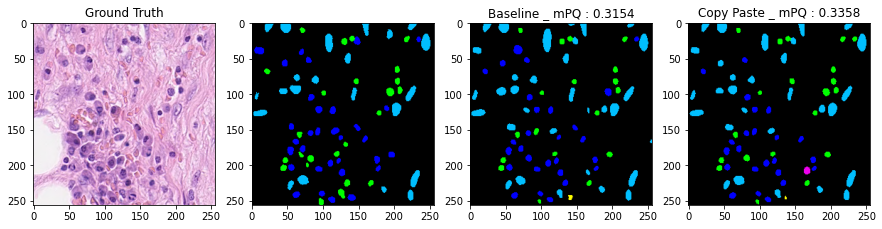

999
[0 3 4 6]


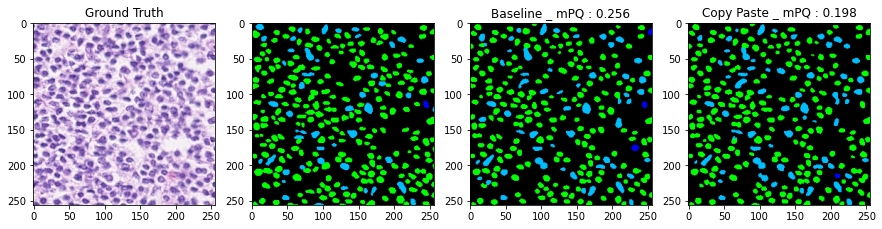

1000
[0 3 6]


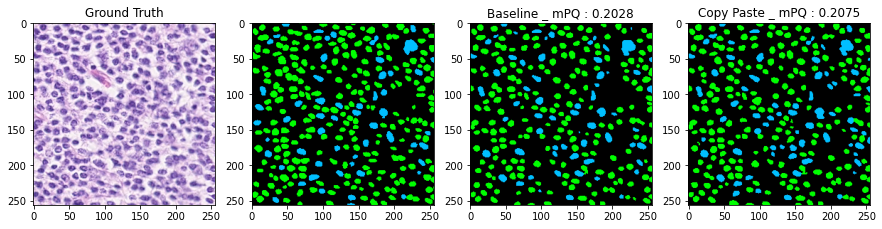

1001
[0 3 4 6]


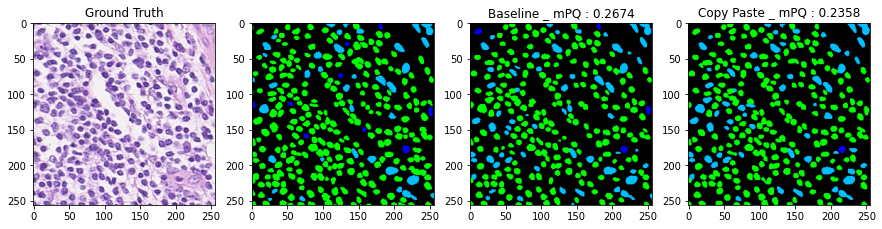

1002
[0 3 4 6]


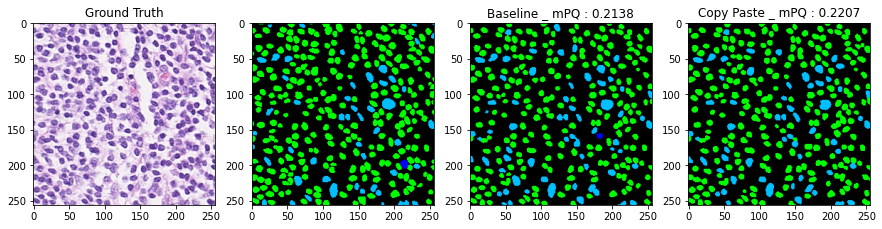

1003
[0 3 4 5 6]


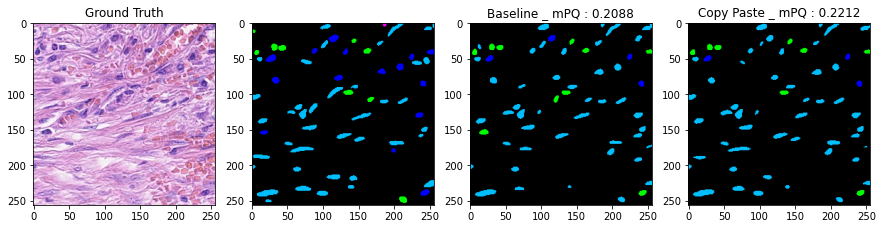

1004
[0 3 4 5 6]


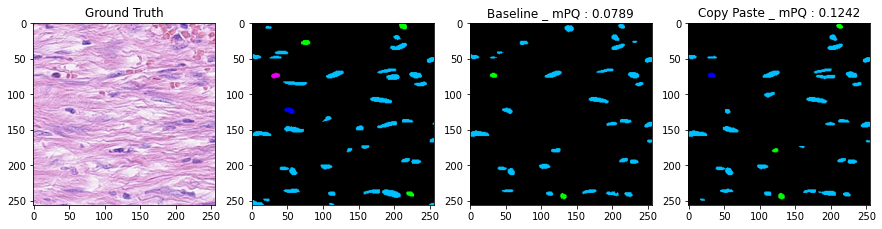

1005
[0 3 4 6]


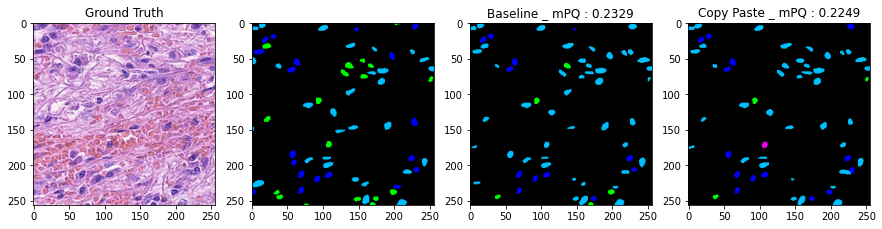

1006
[0 3 4 6]


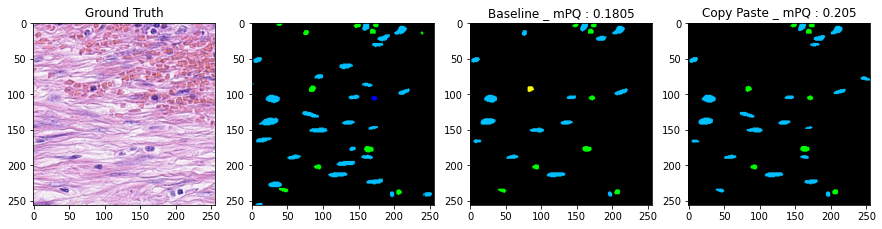

1007
[0 1 3 6]


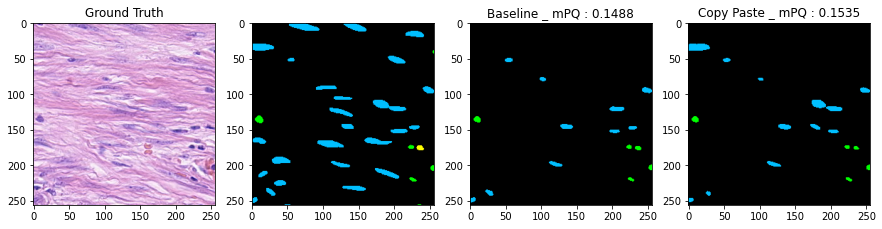

1008
[0 3 4 6]


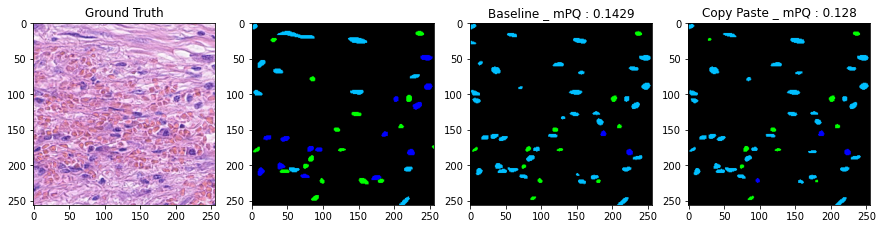

1009
[0 3 6]


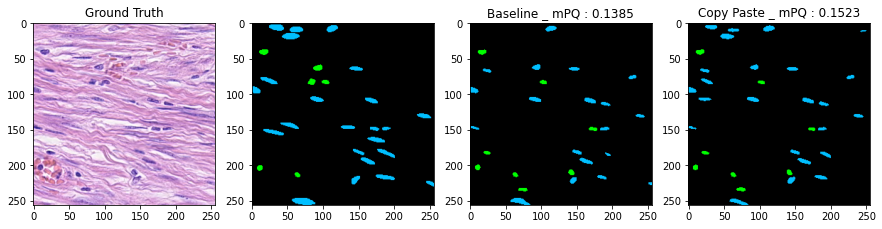

1010
[0 3 4 6]


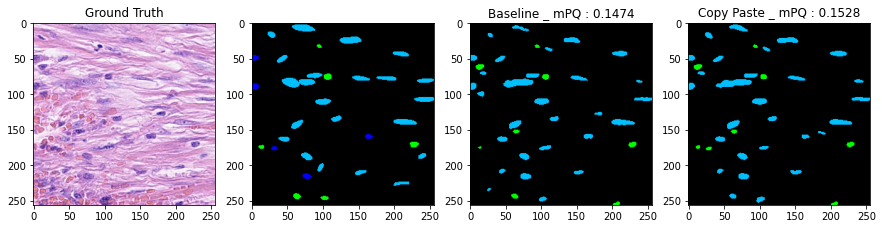

1011
[0 3 4 6]


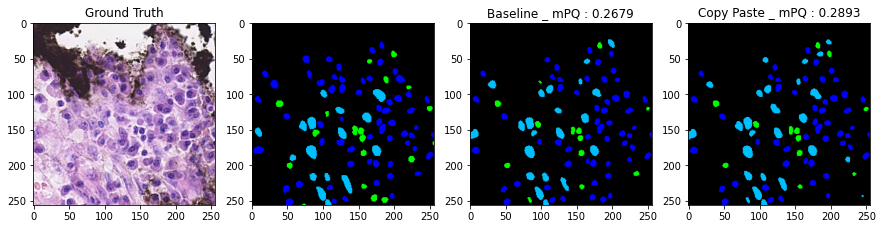

1012
[0 3 4 5 6]


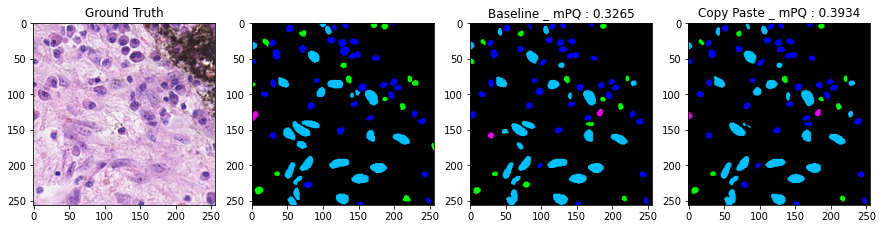

1013
[0 3 4]


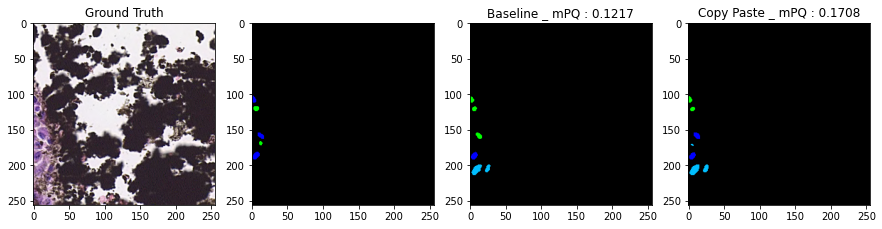

1014
[0 3 4 6]


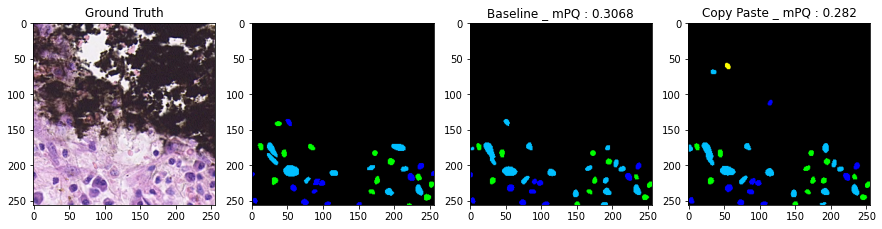

1015
[0 2 3 6]


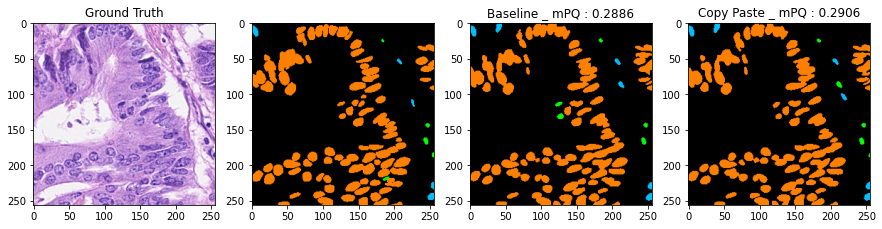

1016
[0 2 3 6]


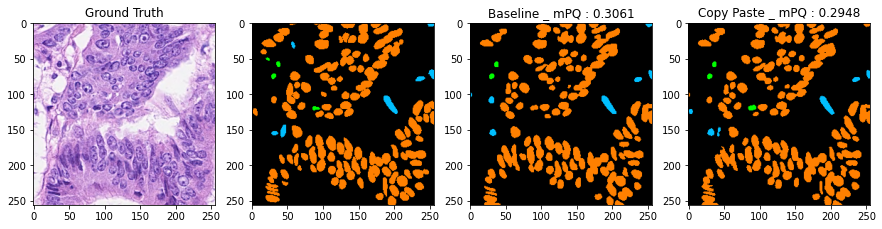

1017
[0 2 3 6]


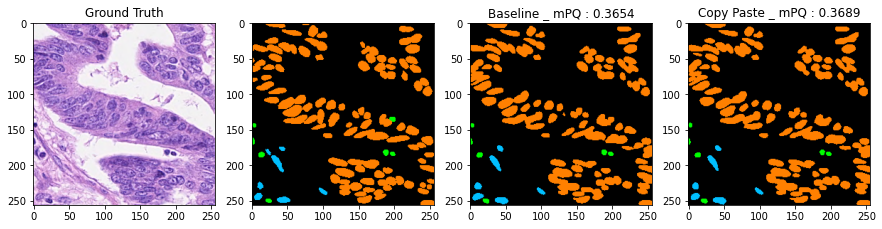

1018
[0 2 3 6]


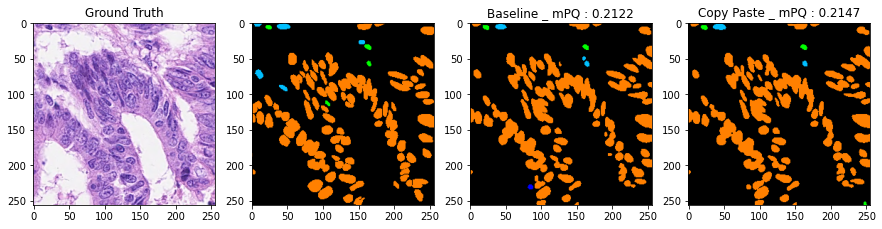

1019


IndexError: index 1018 is out of bounds for axis 0 with size 1018

In [132]:
for i in range(200):
    
    i+=920
    print(i+1)
    
    temp = test_dataset[i]
    image = temp['image']
    mask = temp['mask']
    print(np.unique(temp['mask']))
    
  
    image = test_dataset[i]['image']
    mask_original = test_dataset[i]['mask'][0].numpy().astype('uint8')
    mask_baseline = pred_final_baseline[i][..., 1].astype('uint8')
    mask_copypaste = pred_final_copypaste[i][..., 1].astype('uint8')

    result_baseilne = compute_pq('seg_class', pred_final_baseline[i][None, ...], test_masks[i][None, ...])
    result_copypaste = compute_pq('seg_class', pred_final_copypaste[i][None, ...], test_masks[i][None, ...])
    mPQ_baseline = np.round(result_baseilne['multi_pq+'][0].mean(), 4)
    mPQ_copypaste = np.round(result_copypaste['multi_pq+'][0].mean(), 4)

    vis = {'0' : (0, 0, 0),
           '1' : (255,255,0),
           '2' : (255,128,0),
           '3' : (0, 255, 0),
           '4' : (0, 0, 255),
           '5' : (238, 0, 238),
           '6' : (0, 191, 255)}

    src_original = (image.permute(1, 2, 0).numpy()*255).astype('uint8').copy()
    src_baseline = (image.permute(1, 2, 0).numpy()*255).astype('uint8').copy()
    src_copypaste = (image.permute(1, 2, 0).numpy()*255).astype('uint8').copy()
    
    
    a = mask_original
    original_mask = np.zeros_like(a)[..., None].repeat(3, 2)
    for p in range(original_mask.shape[0]):
        for q in range(original_mask.shape[1]):
            original_mask[p, q, :] = vis['{}'.format(a[p, q])]    
    
    a = pred_final_baseline[i][..., 1].astype('uint8')
    baseline_mask = np.zeros_like(a)[..., None].repeat(3, 2)
    for p in range(baseline_mask.shape[0]):
        for q in range(baseline_mask.shape[1]):
            baseline_mask[p, q, :] = vis['{}'.format(a[p, q])]
    
   
    a = pred_final_copypaste[i][..., 1].astype('uint8')
    copypaste_mask = np.zeros_like(a)[..., None].repeat(3, 2)
    for p in range(copypaste_mask.shape[0]):
        for q in range(copypaste_mask.shape[1]):
            copypaste_mask[p, q, :] = vis['{}'.format(a[p, q])]
    
    
    plt.figure(figsize=(15, 15))
    
    plt.subplot(1, 4, 1)
    plt.imshow(src_original)
    plt.title("Ground Truth")
    
    plt.subplot(1, 4, 2)
    plt.imshow(original_mask)  
    
    plt.subplot(1, 4, 3)
    plt.imshow(baseline_mask)
    plt.title("Baseline _ mPQ : {}".format(mPQ_baseline))
    
    plt.subplot(1, 4, 4)
    plt.imshow(copypaste_mask)
    plt.title("Copy Paste _ mPQ : {}".format(mPQ_copypaste))
    
    plt.show()

293
[0 2 3 6]


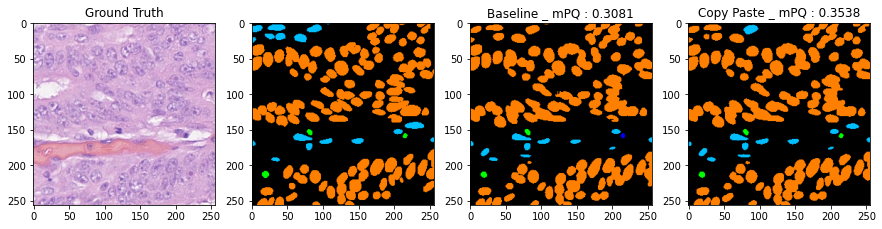

In [110]:
for i in range(100):
    
    i+=292
    print(i+1)
    
    temp = test_dataset[i]
    image = temp['image']
    mask = temp['mask']
    print(np.unique(temp['mask']))
    
  
    image = test_dataset[i]['image']
    mask_original = test_dataset[i]['mask'][0].numpy().astype('uint8')
    mask_baseline = pred_final_baseline[i][..., 1].astype('uint8')
    mask_copypaste = pred_final_copypaste[i][..., 1].astype('uint8')

    result_baseilne = compute_pq('seg_class', pred_final_baseline[i][None, ...], test_masks[i][None, ...])
    result_copypaste = compute_pq('seg_class', pred_final_copypaste[i][None, ...], test_masks[i][None, ...])
    mPQ_baseline = np.round(result_baseilne['multi_pq+'][0].mean(), 4)
    mPQ_copypaste = np.round(result_copypaste['multi_pq+'][0].mean(), 4)

    vis = {'0' : (0, 0, 0),
           '1' : (255,255,0),
           '2' : (255,128,0),
           '3' : (0, 255, 0),
           '4' : (0, 0, 255),
           '5' : (238, 0, 238),
           '6' : (0, 191, 255)}

    src_original = (image.permute(1, 2, 0).numpy()*255).astype('uint8').copy()
    src_baseline = (image.permute(1, 2, 0).numpy()*255).astype('uint8').copy()
    src_copypaste = (image.permute(1, 2, 0).numpy()*255).astype('uint8').copy()
    
    
    a = mask_original
    original_mask = np.zeros_like(a)[..., None].repeat(3, 2)
    for p in range(original_mask.shape[0]):
        for q in range(original_mask.shape[1]):
            original_mask[p, q, :] = vis['{}'.format(a[p, q])]    
    
    a = pred_final_baseline[i][..., 1].astype('uint8')
    baseline_mask = np.zeros_like(a)[..., None].repeat(3, 2)
    for p in range(baseline_mask.shape[0]):
        for q in range(baseline_mask.shape[1]):
            baseline_mask[p, q, :] = vis['{}'.format(a[p, q])]
    
   
    a = pred_final_copypaste[i][..., 1].astype('uint8')
    copypaste_mask = np.zeros_like(a)[..., None].repeat(3, 2)
    for p in range(copypaste_mask.shape[0]):
        for q in range(copypaste_mask.shape[1]):
            copypaste_mask[p, q, :] = vis['{}'.format(a[p, q])]
    
    
    plt.figure(figsize=(15, 15))
    
    plt.subplot(1, 4, 1)
    plt.imshow(src_original)
    plt.title("Ground Truth")
    
    plt.subplot(1, 4, 2)
    plt.imshow(original_mask)  
    
    plt.subplot(1, 4, 3)
    plt.imshow(baseline_mask)
    plt.title("Baseline _ mPQ : {}".format(mPQ_baseline))
    
    plt.subplot(1, 4, 4)
    plt.imshow(copypaste_mask)
    plt.title("Copy Paste _ mPQ : {}".format(mPQ_copypaste))
    
    plt.show() 
    
    break

In [88]:
cv2.imwrite('temp1.png', cv2.cvtColor(src_original, cv2.COLOR_BGR2RGB))
cv2.imwrite('temp2.png', cv2.cvtColor(original_mask, cv2.COLOR_BGR2RGB))
cv2.imwrite('temp3.png', cv2.cvtColor(baseline_mask, cv2.COLOR_BGR2RGB))
cv2.imwrite('temp4.png', cv2.cvtColor(copypaste_mask, cv2.COLOR_BGR2RGB))

True

In [79]:
a1 = np.array([0.2204218 , 0.61823951, 0.68663248, 0.57588596, 0.40827855,
       0.61786705])

a2 = np.array([0.23468951, 0.61095451, 0.71924972, 0.53798574, 0.37986324,
       0.6120874 ])

a3 = np.array([0.33205212, 0.61675098, 0.72230337, 0.53142051, 0.37120816,
       0.60827246])

a4 = np.array([0.3195515 , 0.60606377, 0.71271179, 0.53439587, 0.39571995,
       0.5973613 ])

a5 = np.array([0.25076315, 0.62489379, 0.71151441, 0.5566871 , 0.38280954,
       0.59876391])

result = np.stack([a1, a2, a3, a4, a5])

In [80]:
result.mean(0)

array([0.27149562, 0.61538051, 0.71048235, 0.54727504, 0.38757589,
       0.60687042])

In [75]:
random1 = np.array([([0.24074433, 0.62213054, 0.68331839, 0.56900431, 0.42397778,
       0.62045249])])

random2 = np.array([([0.24240864, 0.61006085, 0.71454736, 0.53756006, 0.39451323,
       0.61353029])])

random3 = np.array([([0.34544626, 0.62130645, 0.72670878, 0.53010273, 0.4023193 ,
       0.61590425])])

random4 = np.array([([0.32420353, 0.6060316 , 0.71334871, 0.53878746, 0.41068971,
       0.60343967])])

random5 = np.array([([0.26606227, 0.62850406, 0.70957557, 0.55323085, 0.38236604,
       0.59804598])])

result = np.stack([random1, random2, random3, random4, random5])

In [76]:
result.mean(0)

array([[0.28377301, 0.6176067 , 0.70949976, 0.54573708, 0.40277321,
        0.61027454]])

In [77]:
source1 = np.array([([0.23473048, 0.61803192, 0.68679781, 0.56984191, 0.42977644,
       0.6220369])])

source2 = np.array([([0.24061637, 0.61235921, 0.71558281, 0.54216545, 0.41033023,
       0.61465139])])

source3 = np.array([([0.36109558, 0.62037665, 0.72383964, 0.53004318, 0.38442555,
       0.61409819])])

source4 = np.array([([0.30078234, 0.60592779, 0.71446955, 0.53353937, 0.40758941,
       0.60122977])])

source5 = np.array([([0.29527353, 0.62598046, 0.7103137 , 0.5512055 , 0.39533868,
       0.60008302])])

result = np.stack([source1, source2, source3, source4, source5])

In [78]:
result.mean(0)

array([[0.28649966, 0.61653521, 0.7102007 , 0.54535908, 0.40549206,
        0.61041985]])

In [71]:
a = [28.64, 61.65, 71.04, 54.53, 40.54, 61.04]

In [72]:
sum(a) / 6

52.906666666666666

# Paper Vis

In [105]:
# i = 103

image = test_dataset[103]['image']
# mask = test_dataset[103]['mask'][0].numpy()

mask = pred_final_[103][..., 1].astype('uint8')



vis = {'0' : (0, 0, 0),
       '1' : (255,255,0),
       '2' : (255,128,0),
       '3' : (0, 255, 0),
       '4' : (0, 0, 255),
       '5' : (238, 0, 238),
       '6' : (0, 191, 255)}

src = (image.permute(1, 2, 0).numpy()*255).astype('uint8').copy()

resize = True
if resize:
    src = cv2.resize(src, None, fx=2, fy=2)
    mask = cv2.resize(mask, None, fx=2, fy=2, interpolation = cv2.INTER_NEAREST)


contours, hierarchy = cv2.findContours((mask == 1).astype('uint8'), cv2.RETR_CCOMP, cv2.CHAIN_APPROX_NONE)
for c in np.unique(mask)[1:]:
    contours, hierarchy = cv2.findContours((mask == c).astype('uint8'), cv2.RETR_CCOMP, cv2.CHAIN_APPROX_NONE)
    for i in range(len(contours)):
        cv2.drawContours(src, [contours[i]], 0, vis['{}'.format(c)], 2)

In [10]:
import time
start = time.localtime()

print(" Start at %04d/%02d/%02d %02d:%02d:%02d" % (start.tm_year, start.tm_mon, start.tm_mday, start.tm_hour, start.tm_min, start.tm_sec))

 Start at 2022/03/01 19:04:44


In [11]:
end = time.localtime()
print(" Inference End at %04d/%02d/%02d %02d:%02d:%02d" % (end.tm_year, end.tm_mon, end.tm_mday, end.tm_hour, end.tm_min, end.tm_sec))

 Inference End at 2022/03/01 19:04:49


In [13]:
end.tm_hour - start.tm_hour

0

In [ ]:
log.info("Inference Time : {} hour {} minutes {} secodes".format(end.tm_hour - start.tm_hour, 
                                                                 end.tm_min - start.tm_min,
                                                                 end.tm_sec - start.tm_sec))

In [9]:
result = compute_pq('seg_class', pred_final, gt_final)

log.info('Test ---- PQ : {:.4f}, DQ : {:.4f}, SQ :{:.4f}, Multi_PQ+ : {:.4f}'
         .format(
                 result['pq'][0],
                 result['DQ'][0].mean(),
                 result['SQ'][0].mean(),
                 result['multi_pq+'][0].mean()))

2022-02-16 15:52:10,492 - INFO - Test ---- PQ : 0.6484, DQ : 0.6458, SQ :0.8261, Multi_PQ+ : 0.5379
|2022-02-16|15:52:10.492| [INFO] Test ---- PQ : 0.6484, DQ : 0.6458, SQ :0.8261, Multi_PQ+ : 0.5379


In [ ]:
threshold 0.1 -> 51.42
threshold 0.2 -> 52.46
threshold 0.3 -> 53.28
threshold 0.4 -> 53.81
threshold 0.5 -> 53.72

class145 -> 53.79